In [10]:
# imports
import os, glob, re
import pandas as pd
import numpy as np
import seaborn as sns

%matplotlib inline
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import scipy
from scipy import stats

import statsmodels.api as sm
from LabData.DataLoaders.MedicalConditionLoader import MedicalConditionLoader
from LabData.DataAnalyses.UKBB_10k.UKBB_survival import *
from LabData.DataAnalyses.UKBB_10k.process_predictions import load_medical, load_outcome, load_age_gender_bmi, load_microbiome


In [2]:
# paths

outdir = '/net/mraid20/export/jafar/UKBioBank/davidpel/UKBB_10K_outputs'
method = 'regularized_cox'
correlation = 'spearman' #'pearson'

topdir = os.path.join(outdir,method)
corrdir = os.path.join(topdir,correlation,'full_ukb')

In [3]:
# general vars

tenk_features_short_names_dict = {"glasses/contacts_condition (For long-sightedness, i.e. for distance and near, but particularly for near tasks like reading (called 'hypermetropia'))":"hypermetropia",
                                  'occuerd_in_past_two_years (Serious illness, injury or assault to yourself)':'Serious illness, injury or assault (past 2 years)',
                                  'weight_changes_in_the_last_year (Yes - lost weight)':'lost weight in the last year',
                                  'diet_major_changes_5years (Yes, because of illness)' : 'diet_major_changes_5years due to illness',
                                  "experiences_interfering_with_usual_activities (Stomach or abdominal pain)" : "Stomach or abdominal pain",
                                  "experiences_interfering_with_usual_activities (Knee pain)" : "Knee pain",
                                  "experiences_interfering_with_usual_activities (Neck or shoulder pain)" : "Neck or shoulder pain",
                                  "experiences_interfering_with_usual_activities (Back pain)" : "Back pain",
                                  "experiences_interfering_with_usual_activities (Headache)" : "Headache",
                                  "people_living_together_retalated (Son and/or daughter (include step-children))" : "live_together (Child/ren)",
                                  "activities_type (Heavy DIY (eg: weeding, lawn mowing, carpentry, digging))" : "activities_type (Heavy DIY)",
                                 }

tenk_prs_short_names_dict = {"Blood clot, DVT, bronchitis, emphysema, asthma, rhinitis, eczema, allergy diagnosed by doctor: Hayfever, allergic rhinitis or eczema":"Hayfever, allergic rhinitis or eczema",
                             "Blood clot, DVT, bronchitis, emphysema, asthma, rhinitis, eczema, allergy diagnosed by doctor: None of the above":"No clot, dvt, bronchitis, asthma, allergy",
                             "Blood clot, DVT, bronchitis, emphysema, asthma, rhinitis, eczema, allergy diagnosed by doctor: Asthma":"Diagnosed asthma",
                             "Vascular/heart problems diagnosed by doctor: None of the above" : "No heart problems diagnosed by doctor",
                             "Vascular/heart problems diagnosed by doctor: High blood pressure" : "High blood pressure diagnosed by doctor",
                             "Non-cancer illness code, self-reported: hypertension" : "Hypertension - self-reported code",
                             "Non-cancer illness code, self-reported: heart attack/myocardial infarction" : "Heart attack/myocardial infarction - self-reported code",
                             "Non-cancer illness code, self-reported: diabetes" : "Diabetes - self-reported code",
                             "Non-cancer illness code, self-reported: high cholesterol" : "High cholestrerol - self-reported code",
                             "Non-cancer illness code, self-reported: asthma" : "Asthma - self-reported code",
                             'Diagnoses - main ICD10: I25 Chronic ischaemic heart disease' : "Chronic ischaemic heart disease",
                              }

tenk_prs_order = ['Pulse rate, automated reading', 'Non-cancer illness code, self-reported: hypertension',
                    'Non-cancer illness code, self-reported: heart attack/myocardial infarction',
                    'Illnesses of father: Heart disease', 'Illnesses of father: High blood pressure', 'Illnesses of mother: High blood pressure',
                    'Illnesses of siblings: Heart disease', 'Illnesses of siblings: High blood pressure','Chest pain or discomfort',
                    'Age high blood pressure diagnosed', 'Diastolic blood pressure, automated reading', 'Systolic blood pressure, automated reading',
                    'Pulse rate', 'Pulse wave reflection index', 'Vascular/heart problems diagnosed by doctor: Heart attack',
                    'Vascular/heart problems diagnosed by doctor: Angina', 'Vascular/heart problems diagnosed by doctor: High blood pressure',
                    'Major coronary heart disease event', 'Ischaemic heart disease, wide definition',
                    'Diseases of the circulatory system',
                    'Coronary atherosclerosis', 'Non-cancer illness code, self-reported: angina',
                    'Diagnoses - main ICD10: I25 Chronic ischaemic heart disease',
                    'Non-cancer illness code, self-reported: diabetes', 'Non-cancer illness code, self-reported: high cholesterol',
                    'Illnesses of father: Diabetes', 'Illnesses of mother: Diabetes', 'Illnesses of siblings: Diabetes',
                    'Diabetes diagnosed by doctor', 'Diagnoses - main ICD10: G56 Mononeuropathies of upper limb',
                    'Wheeze or whistling in the chest in last year', 'Non-cancer illness code, self-reported: asthma',
                    'Blood clot, DVT, bronchitis, emphysema, asthma, rhinitis, eczema, allergy diagnosed by doctor: Asthma',  
                    'Non-cancer illness code, self-reported: hayfever/allergic rhinitis', 'Doctor diagnosed hayfever or allergic rhinitis',
                    'Blood clot, DVT, bronchitis, emphysema, asthma, rhinitis, eczema, allergy diagnosed by doctor: Hayfever, allergic rhinitis or eczema',
                    'Leg pain on walking','Pain type(s) experienced in last month: Knee pain',
                    'Pain type(s) experienced in last month: Hip pain','Diagnoses - main ICD10: M54 Dorsalgia', 'Fractured/broken bones in last 5 years'
                    'Non-cancer illness code, self-reported: depression', 'Mood swings', 'Miserableness', 'Irritability',
                    'Sensitivity / hurt feelings', 'Fed-up feelings','Nervous feelings', 'Worrier / anxious feelings',
                     "Tense / 'highly strung'", 'Worry too long after embarrassment', "Suffer from 'nerves'", 'Neuroticism score',
                     'Loneliness, isolation', 'Guilty feelings', 'Risk taking', 'Ever felt worried, tense, or anxious for most of a month or longer',
                     'Ever had prolonged loss of interest in normal activities', 'Ever had prolonged feelings of sadness or depression',
                     'General happiness', 'General happiness with own health', 'Belief that own life is meaningful', 'Ever thought that life not worth living',
                     'Felt hated by family member as a child', 'Physically abused by family as a child', 'Felt loved as a child',
                     'Felt very upset when reminded of stressful experience in past month', 'Ever sought or received professional help for mental distress',
                     'Frequency of depressed mood in last 2 weeks', 'Ever suffered mental distress preventing usual activities', 'Ever had period extreme irritability',
                     'Trouble falling or staying asleep, or sleeping too much', 'Recent feelings of tiredness or low energy',
                     'Substances taken for depression: Medication prescribed to you (for at least two weeks)', 'Activities undertaken to treat depression: Talking therapies, such as psychotherapy, counselling, group therapy or CBT',
                     'Frequency of unenthusiasm / disinterest in last 2 weeks', 'Frequency of tenseness / restlessness in last 2 weeks',
                     'Frequency of tiredness / lethargy in last 2 weeks', 'Seen doctor (GP) for nerves, anxiety, tension or depression',
                     'Seen a psychiatrist for nerves, anxiety, tension or depression', 'Happiness', 'Health satisfaction', 'Family relationship satisfaction',
                     'Friendships satisfaction', 'Financial situation satisfaction', 'Ever depressed for a whole week',
                     'Pain type(s) experienced in last month: Headache',
                     'Non-cancer illness code, self-reported: hypothyroidism/myxoedema',
                     'Disorders of gallbladder, biliary tract and pancreas']
tenk_prs_order = [tenk_prs_short_names_dict.get(x,x) for x in tenk_prs_order]



ukb_disease_short_names_dict = {"disorders of lipoprotein metabolism and other lipidaemias" : "lipoprotein disorder or lipidaemia",
                                'Other specified conditions associated with the spine (intervertebral disc displacement)' : 'Spine conditions - intervertebral disc displacement',
                                "stroke, not specified as haemorrhage or infarction" : "stroke, not specified",
                                "osteoporosis with pathological fracture" : "osteoporosis"
                               }

ukb_disease_order = ["essential (primary) hypertension","obesity",
                     "disorders of lipoprotein metabolism and other lipidaemias","atherosclerosis",
                     "aortic aneurysm and dissection","other peripheral vascular diseases",
                     "other diseases of liver","fibrosis and cirrhosis of liver",
                     "other inflammatory liver diseases","non-insulin-dependent diabetes mellitus",
                     "unspecified diabetes mellitus","insulin-dependent diabetes mellitus","hyperthyroidism",
                     "other non-toxic goitre","other hypothyroidism","thyroiditis",
                     "osteoporosis with pathological fracture","nonrheumatic aortic valve disorders",
                     "nonrheumatic mitral valve disorders","atrioventricular and left bundle-branch block",
                     "atrial fibrillation and flutter","cardiomyopathy","chronic ischaemic heart disease",
                     "heart failure","other acute ischaemic heart diseases","acute myocardial infarction",
                     "other chronic obstructive pulmonary disease","other interstitial pulmonary diseases",
                     "pulmonary oedema","pulmonary embolism","asthma","chronic sinusitis",
                     "pneumonia, organism unspecified","migraine","parkinson's disease","alzheimer's disease",
                     "vascular dementia","facial nerve disorders",
                     "stroke, not specified as haemorrhage or infarction","cerebral infarction",
                     "other anxiety disorders","recurrent depressive disorder","ulcerative colitis","dyspepsia",
                     "other rheumatoid arthritis","gout","chronic renal failure",'cholelithiasis',
                     "vitamin d deficiency","acute pancreatitis","cellulitis"]
ukb_disease_order = [ukb_disease_short_names_dict.get(x,x) for x in ukb_disease_order]


prs_groups = ([    ['Pulse rate, automated reading', 'Non-cancer illness code, self-reported: hypertension',
                    'Non-cancer illness code, self-reported: heart attack/myocardial infarction',
                    'Illnesses of father: Heart disease', 'Illnesses of father: High blood pressure', 'Illnesses of mother: High blood pressure',
                    'Illnesses of siblings: Heart disease', 'Illnesses of siblings: High blood pressure','Chest pain or discomfort',
                    'Age high blood pressure diagnosed', 'Diastolic blood pressure, automated reading', 'Systolic blood pressure, automated reading',
                    'Pulse rate', 'Pulse wave reflection index', 'Vascular/heart problems diagnosed by doctor: Heart attack',
                     'Vascular/heart problems diagnosed by doctor: High blood pressure',
                    'Major coronary heart disease event', 'Ischaemic heart disease, wide definition',
                    'Diseases of the circulatory system','Coronary atherosclerosis',
                    'Non-cancer illness code, self-reported: angina', 'Vascular/heart problems diagnosed by doctor: Angina',
                    'Diagnoses - main ICD10: I25 Chronic ischaemic heart disease',],
                   ['Coronary atherosclerosis', 'Non-cancer illness code, self-reported: angina', 'Vascular/heart problems diagnosed by doctor: Angina',
                    'Diagnoses - main ICD10: I25 Chronic ischaemic heart disease','Non-cancer illness code, self-reported: diabetes', 'Non-cancer illness code, self-reported: high cholesterol',
                    'Illnesses of father: Diabetes', 'Illnesses of mother: Diabetes', 'Illnesses of siblings: Diabetes',
                    'Diabetes diagnosed by doctor',],
                   ['Non-cancer illness code, self-reported: diabetes', 'Non-cancer illness code, self-reported: high cholesterol',
                    'Illnesses of father: Diabetes', 'Illnesses of mother: Diabetes', 'Illnesses of siblings: Diabetes',
                    'Diabetes diagnosed by doctor','Diagnoses - main ICD10: G56 Mononeuropathies of upper limb',],
                   ['Wheeze or whistling in the chest in last year', 'Non-cancer illness code, self-reported: asthma',
                    'Blood clot, DVT, bronchitis, emphysema, asthma, rhinitis, eczema, allergy diagnosed by doctor: Asthma',],
                   ['Wheeze or whistling in the chest in last year', 'Non-cancer illness code, self-reported: asthma',
                    'Blood clot, DVT, bronchitis, emphysema, asthma, rhinitis, eczema, allergy diagnosed by doctor: Asthma',  
                    'Non-cancer illness code, self-reported: hayfever/allergic rhinitis', 'Doctor diagnosed hayfever or allergic rhinitis',
                    'Blood clot, DVT, bronchitis, emphysema, asthma, rhinitis, eczema, allergy diagnosed by doctor: Hayfever, allergic rhinitis or eczema',],
                   ['Leg pain on walking',],
                   ['Pain type(s) experienced in last month: Knee pain','Pain type(s) experienced in last month: Hip pain',
                    'Leg pain on walking', 'Diagnoses - main ICD10: M54 Dorsalgia',],
                   ['Pain type(s) experienced in last month: Knee pain','Pain type(s) experienced in last month: Hip pain',
                    'Leg pain on walking', 'Diagnoses - main ICD10: M54 Dorsalgia', 'Fractured/broken bones in last 5 years'],
                   ['Non-cancer illness code, self-reported: depression', 'Mood swings', 'Miserableness', 'Irritability',
                    'Sensitivity / hurt feelings', 'Fed-up feelings','Nervous feelings', 'Worrier / anxious feelings',
                     "Tense / 'highly strung'", 'Worry too long after embarrassment', "Suffer from 'nerves'", 'Neuroticism score',
                     'Loneliness, isolation', 'Guilty feelings', 'Risk taking', 'Ever felt worried, tense, or anxious for most of a month or longer',
                     'Ever had prolonged loss of interest in normal activities', 'Ever had prolonged feelings of sadness or depression',
                     'General happiness', 'General happiness with own health', 'Belief that own life is meaningful', 'Ever thought that life not worth living',
                     'Felt hated by family member as a child', 'Physically abused by family as a child', 'Felt loved as a child',
                     'Felt very upset when reminded of stressful experience in past month', 'Ever sought or received professional help for mental distress',
                     'Frequency of depressed mood in last 2 weeks', 'Ever suffered mental distress preventing usual activities', 'Ever had period extreme irritability',
                     'Trouble falling or staying asleep, or sleeping too much', 'Recent feelings of tiredness or low energy',
                     'Substances taken for depression: Medication prescribed to you (for at least two weeks)', 'Activities undertaken to treat depression: Talking therapies, such as psychotherapy, counselling, group therapy or CBT',
                     'Frequency of unenthusiasm / disinterest in last 2 weeks', 'Frequency of tenseness / restlessness in last 2 weeks',
                     'Frequency of tiredness / lethargy in last 2 weeks', 'Seen doctor (GP) for nerves, anxiety, tension or depression',
                     'Seen a psychiatrist for nerves, anxiety, tension or depression', 'Happiness', 'Health satisfaction', 'Family relationship satisfaction',
                     'Friendships satisfaction', 'Financial situation satisfaction', 'Ever depressed for a whole week',],              
                    ['Pain type(s) experienced in last month: Headache',],
                    ['Non-cancer illness code, self-reported: hypothyroidism/myxoedema',],
                    ['Disorders of gallbladder, biliary tract and pancreas']
              ],
              [    ['essential (primary) hypertension', 'nonrheumatic aortic valve disorders', 'nonrheumatic mitral valve disorders',
                    'atrioventricular and left bundle-branch block', 'atrial fibrillation and flutter', 'cardiomyopathy',
                    'chronic ischaemic heart disease', 'heart failure', 'other acute ischaemic heart diseases', 'acute myocardial infarction',
                    'obesity', 'pulmonary oedema', 'other peripheral vascular diseases',],
                   ['disorders of lipoprotein metabolism and other lipidaemias', 'atherosclerosis',
                    'non-insulin-dependent diabetes mellitus', 'unspecified diabetes mellitus',
                    'insulin-dependent diabetes mellitus', 'obesity', 'chronic renal failure', 'essential (primary) hypertension',],
                   ['non-insulin-dependent diabetes mellitus', 'unspecified diabetes mellitus',
                    'insulin-dependent diabetes mellitus',],
                   ['other chronic obstructive pulmonary disease',],
                   ['asthma','chronic_sinusitis'],
                   ['gout'],
                   ['other rheumatoid arthritis',],
                   ['osteoporosis with pathological fracture'],
                   ['recurrent depressive disorder', 'other anxiety disorders'],              
                   ['migraine',],
                   ['other hypothyroidism',],
                   ['cholelithiasis']
              ])

prs_groups = ([[tenk_prs_short_names_dict.get(x,x) for x in y] for y in prs_groups[0]] , 
              [[ukb_disease_short_names_dict.get(x,x) for x in y] for y in prs_groups[1]])


ukb_shared_diseases = ["essential (primary) hypertension","obesity","lipoprotein disorder or lipidaemia",
                       #"atherosclerosis",
                       "other diseases of liver","fibrosis and cirrhosis of liver",
                       "non-insulin-dependent diabetes mellitus",#"unspecified diabetes mellitus",
                       "other hypothyroidism","osteoporosis with pathological fracture",
                       #"nonrheumatic aortic valve disorders","nonrheumatic mitral valve disorders",
                       "asthma",
                       "chronic sinusitis","migraine","other anxiety disorders",
                       "recurrent depressive disorder","dyspepsia", "cholelithiasis"]

tenk_disease_order = ["Essential hypertension","Obesity","Hyperlipoproteinaemia  ",
                      "Non-alcoholic fatty liver disease","Obstructive sleep apnoea",
                      "Intermediate hyperglycaemia ","Thyrotoxicosis","hypothyroidism",
                      "Low bone mass disorders","Osteoarthritis",'Fracture of unspecified body region',
                      #"Heart valve diseases unspecified",
                      "Asthma","Allergic rhinitis ","Chronic rhinosinusitis",
                      "Migraine","Headache disorders","Anxiety or fear-related disorders",
                      "Depressive disorders","Insomnia disorders","Attention deficit hyperactivity disorder",
                      "Chronic widespread pain","Anal fissure","Haemorrhoids",
                      "Oral aphthae or aphtha-like ulceration","Ulcer of stomach or duodenum",
                      "Irritable bowel syndrome","Helicobacter pylori induced gastritis","Spinal pain",
                      "Other specified conditions associated with the spine (intervertebral disc displacement)",
                      "Polycystic ovary syndrome","Endometriosis","Female infertility",
                      "Hyperplasia of prostate","Urinary tract infection, site and agent not specified",
                      "Urolithiasis","Cholelithiasis","Basal cell carcinoma of skin","Atopic eczema",
                      "Psoriasis","Acne","Cataract","Episodic vestibular syndrome",
                      "Acquired hearing impairment","Anaemias or other erythrocyte disorders",
                      "Iron Deficiency Anemia","Vitamin B12 deficiency"]

tenk_shared_diseases = ["Essential hypertension","Obesity","Hyperlipoproteinaemia  ",
                        "Non-alcoholic fatty liver disease","Intermediate hyperglycaemia ","hypothyroidism",
                        "Low bone mass disorders",#'Fracture of unspecified body region',
                        #"Heart valve diseases unspecified",
                        "Asthma","Chronic rhinosinusitis","Migraine",
                        "Headache disorders","Anxiety or fear-related disorders","Depressive disorders",
                        "Ulcer of stomach or duodenum","Cholelithiasis"]

ukb_disease_to_tenk_condition_dict = {"essential (primary) hypertension" : "Essential hypertension",
                                      "obesity" : "Obesity",
                                      "lipoprotein disorder or lipidaemia" : "Hyperlipoproteinaemia  ",
                                      "other diseases of liver" : "Non-alcoholic fatty liver disease",
                                      "non-insulin-dependent diabetes mellitus" : "Intermediate hyperglycaemia ",
                                      "other hypothyroidism" : "hypothyroidism",
                                      "osteoporosis with pathological fracture" : "Low bone mass disorders",
                                      "asthma" : "Asthma",
                                      "chronic sinusitis" : "Chronic rhinosinusitis",
                                      "migraine" : ["Migraine","Headache disorders"],
                                      "other anxiety disorders" : "Anxiety or fear-related disorders",
                                      "recurrent depressive disorder" : "Depressive disorders",
                                      "dyspepsia" : "Ulcer of stomach or duodenum",
                                      "cholelithiasis" : "Cholelithiasis"
                                     }

tenk_condition_to_ukb_disease_dict = {"Essential hypertension" : "essential (primary) hypertension",
                                      "Obesity" : "obesity",
                                      "Hyperlipoproteinaemia  " : "lipoprotein disorder or lipidaemia",
                                      "Non-alcoholic fatty liver disease" : "other diseases of liver",
                                      "Intermediate hyperglycaemia " : "non-insulin-dependent diabetes mellitus",
                                      "hypothyroidism" : "other hypothyroidism",
                                      "Low bone mass disorders" : "osteoporosis with pathological fracture",
                                      "Asthma" : "asthma",
                                      "Chronic rhinosinusitis" : "chronic sinusitis",
                                      "Migraine" : "migraine",
                                      "Headache disorders" : "migraine",
                                      "Anxiety or fear-related disorders" : "other anxiety disorders",
                                      "Depressive disorders" : "recurrent depressive disorder",
                                      "Ulcer of stomach or duodenum" : 'dyspepsia',
                                      "Cholelithiasis" : "cholelithiasis"
                                     }


drop_outcomes = [130736,132054,132072,132152,131620,131612,131636] # These were not run or are gender specific

drop_cancer_outcomes = ["C61","C56","C20"]

m_conditions = ["Hyperplasia of prostate"]
f_conditions = ['Polycystic ovary syndrome',"Endometriosis","Female infertility"]#,'haemolytic anaemia due to G6PD deficiency']

loaders = ['retina', 'microbiome', 'sleep',  'ecg', 'cgm', 'dexa', # 'bloodtests', 'bodymeasures', \ 
                'carotid','abi', 'diet', 'metabolomics','liver','age_gender_bmi'] # , 'diet'

# features that basically overlap with an input feature
drop_features_dict = {'sleep' : ['MeanPRSleep'],
                      'ecg' : ['hr_bpm'],
                      'abi' : ['l_brachial_pressure', 'r_brachial_pressure'], # 'l_ankle_pressure', 'r_ankle_pressure'
                      'cgm' : ['eA1C'],
                      'dexa' : ['body_comp_trunk_region_percent_fat', 'body_comp_total_region_percent_fat'],
                      'diet' : [],
                      'cgm_main' : ['eA1C']
                     }




In [4]:
# more complex vars

outcomes_df = pd.read_csv(os.path.join(os.path.dirname(outdir),'UKBB_data','outcomes.csv'))

outcomes_dict = dict(zip(outcomes_df['UKBB Field ID'].values,outcomes_df['UKBB Description'].values))
for o in outcomes_dict:
    outcomes_dict[o] = '('.join(outcomes_dict[o][:-1].split('(')[1:])
for k in drop_outcomes:
    outcomes_dict.pop(k,None)
    
outcomes_inv_dict = {ukb_disease_short_names_dict.get(v,v):k for k,v in outcomes_dict.items()}
    
    
cancer_outcomes_df = pd.read_csv(os.path.join(os.path.dirname(outdir),'UKBB_data','cancer_outcomes.csv'))

cancer_outcomes_dict = dict(zip(cancer_outcomes_df['ICD10'].values,cancer_outcomes_df['Type of cancer'].values))
for k in drop_cancer_outcomes:
    cancer_outcomes_dict.pop(k,None)    



In [6]:
# Fig 1b - ukb features-conditions

feature_files = glob.glob(topdir+"/*/full_ukb/*_significant.csv")
feature_files = [f for f in feature_files if not re.search(r'/[^/]+/C[^/]+/full_ukb/[^/]+\.csv',f)] # non-cancer
features_dict = {}
for f in feature_files:
    df = pd.read_csv(f)
    outcome = os.path.basename(f).split('_')[0]
    features_dict[outcomes_dict[int(outcome)]] = df['covariate'].to_list()


dfs = [pd.get_dummies(pd.Series(features)) for features in features_dict.values()]
features_df = pd.concat(dfs, keys=features_dict.keys()).sum(level=0)


row_sums = features_df.sum(axis=1)
col_sums = features_df.sum(axis=0)
drop_row = features_df.index[row_sums<5] # < 1] # uncomment for supp fig
drop_col = features_df.columns[col_sums<10] # < 1] # uncomment for supp fig

features_dropped = features_df.drop(drop_row,axis=0).drop(drop_col,axis=1)
features_dropped.rename(columns = tenk_features_short_names_dict, index= ukb_disease_short_names_dict,
                        inplace=True)

features_dropped = features_dropped.reindex(index=\
                                            [r for r in ukb_disease_order if r in features_dropped.index])

g = sns.clustermap(features_dropped,cmap='binary',dendrogram_ratio=(0.0,0.0),colors_ratio=0.01, col_cluster=True, row_cluster=False, cbar_pos=None,metric='hamming',figsize=(11,12)) # 22,12)) # uncomment for supp #,col_cluster=False)#,cbar_kws = {'ticks':[0,1],'orientation':'horizontal'})
g.ax_heatmap.yaxis.tick_left()
g.ax_heatmap.set_xticklabels(g.ax_heatmap.get_xticklabels(), rotation=30, rotation_mode='anchor', ha='right',fontsize=15)
g.ax_heatmap.set_yticklabels(g.ax_heatmap.get_yticklabels(),fontsize=15)

plt.tight_layout()
plt.savefig(os.path.join(topdir,'outcome_clusters.png'),dpi=300) # _supp.png'))
plt.clf()





/tmp/ipykernel_75961/722544565.py:12: FutureWarning: The default dtype for empty Series will be 'object' instead of 'float64' in a future version. Specify a dtype explicitly to silence this warning.
  dfs = [pd.get_dummies(pd.Series(features)) for features in features_dict.values()]
/tmp/ipykernel_75961/722544565.py:13: FutureWarning: Using the level keyword in DataFrame and Series aggregations is deprecated and will be removed in a future version. Use groupby instead. df.sum(level=1) should use df.groupby(level=1).sum().
  features_df = pd.concat(dfs, keys=features_dict.keys()).sum(level=0)


In [87]:
# Fig 2a - plot pseudo-outcomes
# functions
def plot_pseudo_outcomes():
    preds = {}
    for o in outcomes_dict:
        pred = load_outcome(o) / 365.
        pred.columns = [outcomes_dict[o]]
        preds[o] = pred
    df = pd.concat(preds.values(),axis=1)
    df = df.rename(columns=ukb_disease_short_names_dict)
    print(df.info())
    df_melted = df.melt(var_name="Outcome",value_name="Time to event")

    plt.figure(figsize=(17, 9),dpi=300)
    sns.boxplot(x='Outcome', y='Time to event', data=df_melted, order=[x for x in ukb_disease_order if x in df.columns])
    plt.xticks(rotation=45,ha='right',fontsize=14)
    plt.yticks(fontsize=14)
    plt.xlabel('')
    plt.ylabel('Pseudo-outcomes: expected disease onset (years)', fontsize=16)
    plt.tight_layout()
    plt.savefig(os.path.join(topdir,'pseudo_outcome_distributions'))

Loaded predictions for 131286
Loaded predictions for 131298
Loaded predictions for 131306
Loaded predictions for 130714
Loaded predictions for 131494
Loaded predictions for 131670
Loaded predictions for 131668
Loaded predictions for 131666
Loaded predictions for 130792
Loaded predictions for 130706
Loaded predictions for 130708
Loaded predictions for 131304
Loaded predictions for 131324
Loaded predictions for 131322
Loaded predictions for 131338
Loaded predictions for 131354
Loaded predictions for 131350
Loaded predictions for 131380
Loaded predictions for 131382
Loaded predictions for 131468
Loaded predictions for 131492
Loaded predictions for 131524
Loaded predictions for 131456
Loaded predictions for 131022
Loaded predictions for 131036
Loaded predictions for 131064
Loaded predictions for 131366
Loaded predictions for 131052
Loaded predictions for 130838
Loaded predictions for 130906
Loaded predictions for 130896
Loaded predictions for 131850
Loaded predictions for 131858
Loaded pre

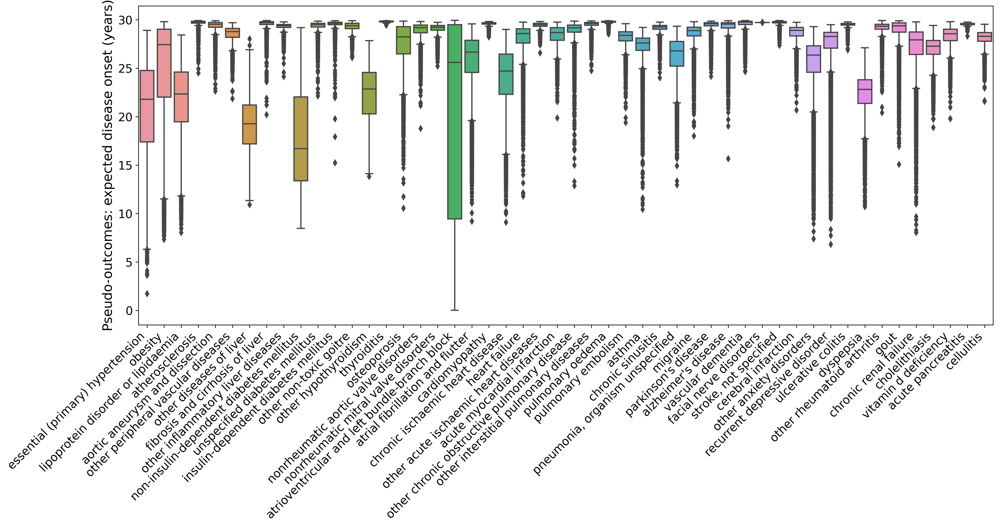

In [88]:
# Fig 2a - plot pseudo-outcomes
# run

plot_pseudo_outcomes()


In [90]:
preds = {}
for o in outcomes_dict:
    pred = load_outcome(o) / 365.
    pred.columns = [outcomes_dict[o]]
    preds[o] = pred
df = pd.concat(preds.values(),axis=1)
df = df.rename(columns=ukb_disease_short_names_dict)
df

Loaded predictions for 131286
Loaded predictions for 131298
Loaded predictions for 131306
Loaded predictions for 130714
Loaded predictions for 131494
Loaded predictions for 131670
Loaded predictions for 131668
Loaded predictions for 131666
Loaded predictions for 130792
Loaded predictions for 130706
Loaded predictions for 130708
Loaded predictions for 131304
Loaded predictions for 131324
Loaded predictions for 131322
Loaded predictions for 131338
Loaded predictions for 131354
Loaded predictions for 131350
Loaded predictions for 131380
Loaded predictions for 131382
Loaded predictions for 131468
Loaded predictions for 131492
Loaded predictions for 131524
Loaded predictions for 131456
Loaded predictions for 131022
Loaded predictions for 131036
Loaded predictions for 131064
Loaded predictions for 131366
Loaded predictions for 131052
Loaded predictions for 130838
Loaded predictions for 130906
Loaded predictions for 130896
Loaded predictions for 131850
Loaded predictions for 131858
Loaded pre

,essential (primary) hypertension,acute myocardial infarction,chronic ischaemic heart disease,unspecified diabetes mellitus,asthma,other diseases of liver,other inflammatory liver diseases,fibrosis and cirrhosis of liver,obesity,insulin-dependent diabetes mellitus,...,cellulitis,cholelithiasis,thyroiditis,thyrotoxicosis [hyperthyroidism],other hypothyroidism,other non-toxic goitre,ulcerative colitis,vitamin d deficiency,acute pancreatitis,lipoprotein disorder or lipidaemia
RegistrationCode,,,,,,,,,,,,,,,,,,,,,
10K_1001201093,27.089755,29.449824,28.563759,29.705277,28.087158,24.657296,29.665431,29.856739,29.627496,29.697829,...,29.048037,28.174574,29.771225,29.005336,21.155961,29.068815,29.570677,28.202406,29.644483,26.012690
10K_1002033709,25.879535,29.319691,27.015150,29.569557,25.894965,22.414895,29.409149,29.625671,29.462940,29.522899,...,28.973900,28.136600,29.672869,29.005336,18.962378,29.391155,29.370528,28.169231,29.601185,23.594002
10K_1002087123,11.285343,28.482305,24.379727,28.882229,26.511671,14.297840,29.247657,29.810828,7.749213,29.609334,...,23.698312,22.511857,29.803974,29.005336,20.806790,28.620446,29.303871,27.910047,29.178190,21.724358
10K_1002254441,27.249318,28.850112,26.259837,29.598066,28.108270,20.360359,29.580958,29.734952,29.045497,29.724846,...,27.771396,28.351656,29.839914,29.005338,24.932486,29.581724,29.663478,29.039845,29.631615,21.324931
10K_1003113258,15.783716,28.264908,22.051602,29.477261,26.891709,20.654709,29.376985,29.848203,28.707299,29.561084,...,29.286359,26.337328,29.862658,29.005337,23.166041,29.674404,29.432105,28.217566,29.577982,22.226215
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10K_7876002964,14.253603,28.355727,16.871787,29.408873,27.631442,14.531325,29.152685,28.963566,15.572362,29.719961,...,26.252040,25.647612,29.843117,29.005337,21.688040,29.194010,29.604790,28.459265,29.509684,14.366277
10K_8163597441,15.467427,27.441490,19.722691,29.569528,28.434724,17.948637,29.488812,29.476152,26.329203,29.790530,...,27.597359,27.963910,29.876862,29.005338,25.766658,29.704910,29.587924,29.306352,29.597031,17.424820
10K_8274147694,22.939228,28.974037,22.734055,29.729217,27.933253,19.216241,29.560916,29.533232,29.077072,29.794061,...,28.136767,27.478363,29.820094,29.005337,22.531567,29.233989,29.616324,28.689748,29.588364,19.718725


In [97]:
from LabData.DataLoaders.BodyMeasuresLoader import BodyMeasuresLoader
bm = BodyMeasuresLoader().get_data(study_ids=['10K'], research_stage=['baseline']).df
bm = bm.reset_index()
bm[bm['RegistrationCode'].isin(df.index)]['Date'].max()


Timestamp('2023-08-07 16:45:40.647890')

In [94]:
df.index

Index(['10K_1001201093', '10K_1002033709', '10K_1002087123', '10K_1002254441',
       '10K_1003113258', '10K_1006172497', '10K_1007400622', '10K_1007474664',
       '10K_1007699078', '10K_1008294272',
       ...
       '10K_2532844416', '10K_3253324618', '10K_3923294971', '10K_3987704989',
       '10K_7366102953', '10K_7876002964', '10K_8163597441', '10K_8274147694',
       '10K_9775688680', '10K_9977494762'],
      dtype='object', name='RegistrationCode', length=10499)

Loaded predictions for 131286
Loaded predictions for 131298
Loaded predictions for 131306
Loaded predictions for 130714
Loaded predictions for 131494
Loaded predictions for 131670
Loaded predictions for 131668
Loaded predictions for 131666
Loaded predictions for 130792
Loaded predictions for 130706
Loaded predictions for 130708
Loaded predictions for 131304
Loaded predictions for 131324
Loaded predictions for 131322
Loaded predictions for 131338
Loaded predictions for 131354
Loaded predictions for 131350
Loaded predictions for 131380
Loaded predictions for 131382
Loaded predictions for 131468
Loaded predictions for 131492
Loaded predictions for 131524
Loaded predictions for 131456
Loaded predictions for 131022
Loaded predictions for 131036
Loaded predictions for 131064
Loaded predictions for 131366
Loaded predictions for 131052
Loaded predictions for 130838
Loaded predictions for 130906
Loaded predictions for 130896
Loaded predictions for 131850
Loaded predictions for 131858
Loaded pre

<Figure size 640x480 with 0 Axes>

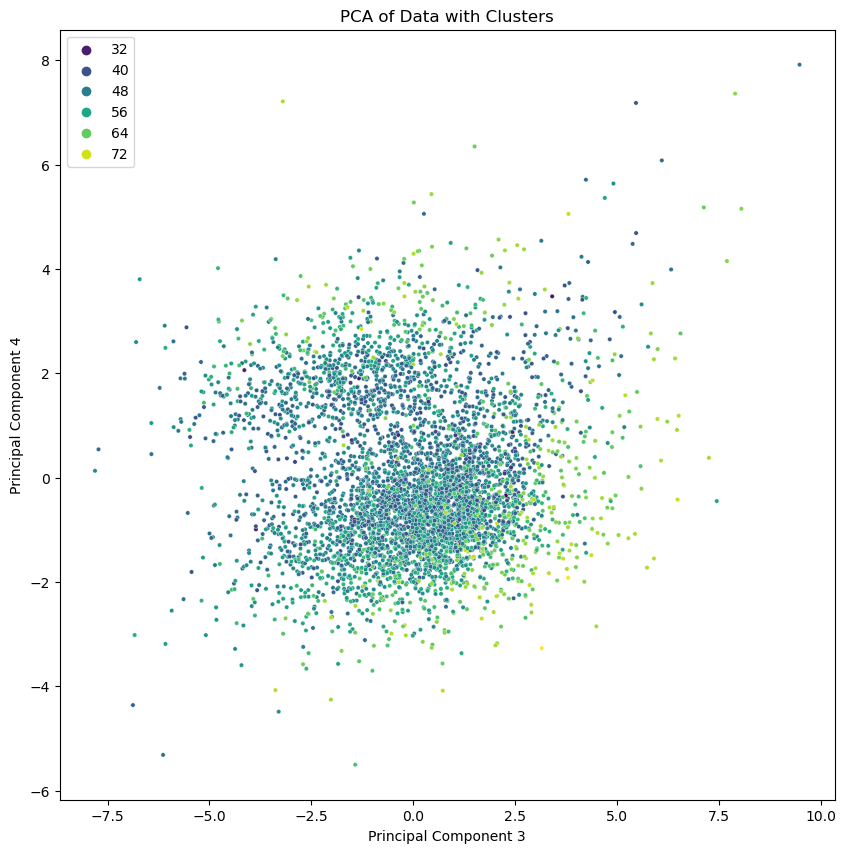

Explained Variance by Component: [37.64675241 14.11084046  7.66853046  4.3504808   3.24453059]
Cumulative Explained Variance: [37.64675241 51.75759287 59.42612333 63.77660413 67.02113473]

PCA Loadings:
                                                    PC1       PC2       PC3  \
essential (primary) hypertension              -0.172724 -0.019057 -0.091805   
acute myocardial infarction                   -0.187766  0.030251 -0.027297   
chronic ischaemic heart disease               -0.195412  0.103161 -0.064414   
unspecified diabetes mellitus                 -0.141466 -0.121763 -0.228984   
asthma                                        -0.055596 -0.193846  0.065957   
other diseases of liver                       -0.117832 -0.102668 -0.250907   
other inflammatory liver diseases             -0.126577 -0.126583 -0.214360   
fibrosis and cirrhosis of liver               -0.068842  0.013094 -0.155775   
obesity                                       -0.100058 -0.087464 -0.337136   
insulin

<Figure size 640x480 with 0 Axes>

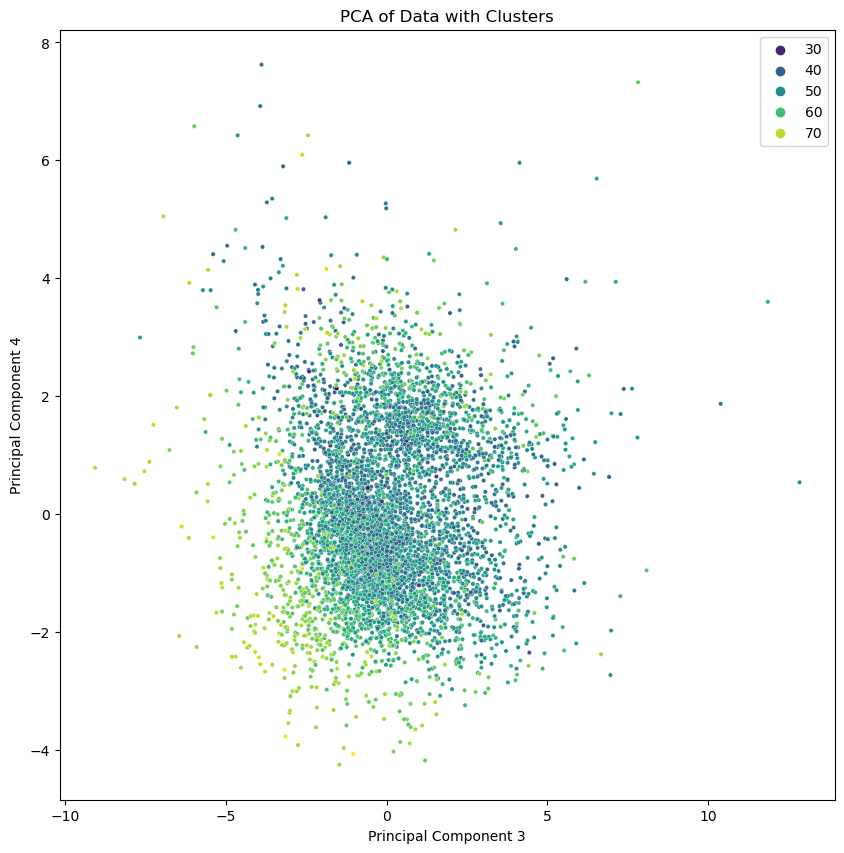

In [178]:
## Couldn't find anything by doing this. 
## Tried to do PCA/tSNE of pseudo-outcomes. In tSNE I see two large clusters but they're not of a specific
## pseudo-outcome


from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.mixture import GaussianMixture
from sklearn.metrics import silhouette_score
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LinearRegression
from sklearn.manifold import TSNE




def pca_plot_gendered(df,gender):
    
    # regress out age and bmi
    X = df.drop(columns=['age','bmi'])
#     residuals = pd.DataFrame(index=df.index)

#     for column in X.columns:  # Iterate over the original features
#         y = df[column]  # Feature to adjust
#         X = df[['age', 'bmi']]  # Covariates
#         model = LinearRegression()
#         model.fit(X, y)
#         predicted = model.predict(X)  # Predicted values based on age and BMI
#         residuals[column] = y - predicted  # Store the residuals

#     # Residuals are the dataset with age and BMI regressed out
#     X_adjusted = residuals
    
    scaler = StandardScaler()
    df_scaled = scaler.fit_transform(X)
#     ncomp=25
    pca = PCA(n_components=0.65)
    
    pca_res = pca.fit_transform(df_scaled)
    df_pca = pd.DataFrame(pca_res,columns=[f'PC{i+1}' for i in range(pca.n_components_)],index=df.index)
    
    
    explained_variance = pca.explained_variance_ratio_ * 100
    print(f"Explained Variance by Component: {explained_variance}")
    print(f"Cumulative Explained Variance: {np.cumsum(explained_variance)}")
    
    # Print PCA loadings
    loadings = pd.DataFrame(pca.components_.T, columns=df_pca.columns, index=X.columns)
    print("\nPCA Loadings:")
    print(loadings)

    
#     tsne = TSNE(n_components=2)
#     tsne_results = tsne.fit_transform(df_scaled)

#     # Create a new DataFrame with t-SNE results
#     df_tsne = pd.DataFrame(tsne_results, columns=[f'TSNE{i+1}' for i in range(tsne.embedding_.shape[1])], index=df.index)
    
#     plt.clf()
#     plt.figure(figsize=(10, 10))
#     for col in df.columns:
#         df_tsne[col] = df[col]
#     # Plot the t-SNE
#     sns.scatterplot(
#         x='TSNE1', y='TSNE2', data=df_tsne,
#         hue = 'atrioventricular and left bundle-branch block', palette='viridis',  # Replace with 'gender' or another column if desired
#         s=10
#     )

#     plt.title("t-SNE Visualization")
#     plt.show()
    
#     silhouette_scores = []
#     k_range = range(2, 56)  # Test clusters from 2 to 10
#     for k in k_range:
#         kmeans = KMeans(n_clusters=k)
#         labels = kmeans.fit_predict(df_pca)
# #         gmm = GaussianMixture(n_components=k)
# #         labels = gmm.fit_predict(df_pca)
#         silhouette_scores.append(silhouette_score(df_pca, labels))

#     optimal_k = 3#k_range[np.argmax(silhouette_scores)]
# #     print(silhouette_scores)
#     print(f"Optimal number of clusters: {optimal_k}")
    
# #     kmeans = KMeans(n_clusters=optimal_k)
# #     cluster_labels = kmeans.fit_predict(df_pca)#.drop(columns='PC1'))#[['PC2','PC4']])
#     gmm = GaussianMixture(n_components=optimal_k)
#     cluster_labels = gmm.fit_predict(df_pca)#.drop(columns='PC1'))#[['PC2','PC4']])
#     df_pca['Cluster'] = cluster_labels

    df_pca['age'] = df['age']
    df_pca['bmi'] = df['bmi']
    
    
    clust1 = df[(df_pca['PCA4']<=0)]
    clust2 = df[~(df_pca['PCA4']<=0)]
    
#     print(clust1.mean())
#     print(clust2.mean())
    
#     print((clust1.mean()-clust2.mean()).sort_values())

#     # Step 5: Plot PCA with clusters
    plt.clf()
    plt.figure(figsize=(10, 10))
    sns.scatterplot(
        x='PC3', y='PC4', hue='age', data=df_pca,
        palette='viridis',  s=10
    )
    plt.title("PCA of Data with Clusters")
    plt.xlabel("Principal Component 3")
    plt.ylabel("Principal Component 4")
    plt.legend(title="")
    plt.show()


def plot_pca():
    preds = {}
    for o in outcomes_dict:
        pred = load_outcome(o) / 365.
        pred.columns = [outcomes_dict[o]]
        preds[o] = pred
    df = pd.concat(preds.values(),axis=1)
    df = df.rename(columns=ukb_disease_short_names_dict)
    
    age_gender_bmi = load_age_gender_bmi()
    merged = df.merge(age_gender_bmi,how='inner',left_index=True, right_index=True)
    df_m = merged[merged['gender']==1].drop(columns='gender').dropna(how='any')
    df_f = merged[merged['gender']==0].drop(columns='gender').dropna(how='any')
    pca_plot_gendered(df_m,'Male')
    pca_plot_gendered(df_f,'Female')    
    
    
    
plot_pca()


In [ ]:
# Fig 2b - disease odds
# functions

def get_odds_by_gender(ukb_preds, tenk_condition, age_gender_bmi, res_df, ukb_disease, tenk_cond):
        
        merged = pd.concat([tenk_condition,ukb_preds,age_gender_bmi],axis=1).dropna(
                    subset=ukb_preds.columns.to_list()).dropna(subset=age_gender_bmi.columns.to_list())
        m_merged = merged[merged['gender']==1].drop(columns='gender')
        f_merged = merged[merged['gender']==0].drop(columns='gender')

        m_y = m_merged.iloc[:,0]
        m_X = m_merged.iloc[:,1:]
        m_X = sm.add_constant(m_X)
        if tenk_condition not in f_conditions:
            m_model = sm.Logit(m_y,m_X,missing='drop').fit(disp=0)

            m_pvals = m_model.pvalues['predictions']
            m_ors = 1/np.exp(m_model.params['predictions'])
            
        f_y = f_merged.iloc[:,0]
        f_X = f_merged.iloc[:,1:]
        f_X = sm.add_constant(f_X)
        if tenk_condition not in m_conditions:
            f_model = sm.Logit(f_y,f_X,missing='drop').fit(disp=0)

            f_pvals = f_model.pvalues['predictions']
            f_ors = 1/np.exp(f_model.params['predictions'])
            
        
        new_row = { "ukbb disease" : ukb_disease,
                    "tenk cond" : tenk_cond,
                    "m_or" : m_ors,
                    "m_pval" : m_pvals,
                    "f_or" : f_ors,
                    "f_pval" : f_pvals}
        
        res_df = res_df.append(new_row,ignore_index=True)
            
        return res_df

def plot_ors(df, alpha = 0.05, prefix=None):

    df["pval"]*=(2*len(df)) # bonferroni correct for both male and female
    
   # df["sig"] = df["pval"]<alpha
    print(df[df["pval"]>=alpha])
    df = df[df["pval"]<alpha]
    
    sorted_df = df.sort_values(by="or",ascending=True)
    
    
    plt.clf()
    
    fig, ax1 = plt.subplots(figsize=(16, 7))
    ax2 = ax1.twinx()
    ax1.set_xlabel('Odds ratio', fontsize=24)

    
    sns.scatterplot(data=sorted_df,y="tenk cond",x="or", s=80, ax=ax1)#,hue="sig",palette={True:"slategray",False:"lightgray"})
    ax1.set(ylabel=None)
    ax2.set(ylabel=None)
    ax1.tick_params(axis='y', labelsize=19)
    ax1.tick_params(axis='x', labelsize=19)
    ax2.tick_params(axis='y', labelsize=19)

    ax2.set_yticks(range(len(sorted_df)))
    ax2.set_yticklabels(sorted_df['ukbb disease'])
    ax1.set_yticks(range(len(sorted_df)))
    ax1.set_yticklabels(sorted_df['tenk cond'])
    
    ax1.set_ylim(-0.5, len(sorted_df) - 0.5)
    ax2.set_ylim(-0.5, len(sorted_df) - 0.5)
    
    

    ax1.annotate(
        'Condition',
        xy=(-0.1, 1.01),
        xycoords='axes fraction',
        ha='right',
        fontsize=22,
    )
    
    ax2.annotate(
        'Predicted condition',
        xy=(1.1, 1.01),
        xycoords='axes fraction',
        ha='left',
        fontsize=22,
    )
    
    if prefix is not None:
        ax1.set_title(prefix,fontsize=24)


#    for index, row in sorted_df.iterrows():
 #       ax1.text(row['or'], -0.04, row['ukbb disease'], va='center', ha='center', fontsize=14, rotation='vertical')
    
    plt.tight_layout()
    
    fname = "condition_ors.png"
    if prefix is not None:
        fname = f"condition_ors_{prefix}_new.png"
    plt.savefig(os.path.join(topdir,fname),dpi=300)
    plt.clf()
    
    
    
def plot_ors_by_gender(df):
    
    m_df = df[["ukbb disease", "tenk cond", "m_or", "m_pval"]]
    
    plot_ors(m_df.rename(columns = {"m_or":"or", "m_pval":"pval"}),prefix='Male')
    
    f_df = df[["ukbb disease", "tenk cond", "f_or", "f_pval"]]
    
    plot_ors(f_df.rename(columns = {"f_or":"or", "f_pval":"pval"}),prefix='Female')



In [70]:
# Fig 2b - disease odds
# run

conditions = load_medical()
age_gender_bmi = load_age_gender_bmi()

results_cols = ["ukbb disease", "tenk cond", "m_or", "m_pval","f_or", "f_pval"]


df = pd.DataFrame(columns = results_cols)

for disease in ukb_disease_to_tenk_condition_dict:
    
    disease_id = outcomes_inv_dict[ukb_disease_short_names_dict.get(disease,disease)]
    preds = load_outcome(disease_id)
    preds /= 365
    condition = ukb_disease_to_tenk_condition_dict[disease]
    condition_cols = conditions[condition]
    
    if isinstance(condition_cols,pd.Series):
        df = get_odds_by_gender(preds, condition_cols, age_gender_bmi, df, disease, condition)
    else:
        for cond in condition_cols:
            df = get_odds_by_gender(preds, condition_cols[cond], age_gender_bmi, df, disease, cond)
            
plot_ors_by_gender(df)
    

/home/davidpel/PycharmProjects/LabData/LabData/DataLoaders/helpers_10k.py:119: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  timeline = pd.read_csv(tenk_visit_file).append(pd.read_csv(tenk_call_file))
/home/davidpel/PycharmProjects/LabData/LabData/DataLoaders/helpers_10k.py:127: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] = newvals` or, if columns are non-unique, `df.isetitem(i, newvals)`
  df2.loc[:,'done_at'] = pd.to_datetime(df2['done_at'].str.split('+', expand=True)[0])
/home/davidpel/PycharmProjects/LabData/LabData/DataLoaders/helpers_10k.py:130: FutureWarning: In a future version, `df.iloc[:, i] = newvals` will attempt to set the values inplace instead of always setting a new array. To retain the old behavior, use either `df[df.columns[i]] =

Loaded age, gender, bmi
Loaded predictions for 131286
Loaded predictions for 130792
Loaded predictions for 130814


/tmp/ipykernel_59536/1223180635.py:37: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  res_df = res_df.append(new_row,ignore_index=True)
/tmp/ipykernel_59536/1223180635.py:37: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  res_df = res_df.append(new_row,ignore_index=True)
/tmp/ipykernel_59536/1223180635.py:37: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  res_df = res_df.append(new_row,ignore_index=True)
/tmp/ipykernel_59536/1223180635.py:37: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  res_df = res_df.append(new_row,ignore_index=True)


Loaded predictions for 131670
Loaded predictions for 130708
Loaded predictions for 130696


/tmp/ipykernel_59536/1223180635.py:37: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  res_df = res_df.append(new_row,ignore_index=True)
/tmp/ipykernel_59536/1223180635.py:37: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  res_df = res_df.append(new_row,ignore_index=True)
/tmp/ipykernel_59536/1223180635.py:37: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  res_df = res_df.append(new_row,ignore_index=True)


Loaded predictions for 131962
Loaded predictions for 131494
Loaded predictions for 131468


/tmp/ipykernel_59536/1223180635.py:37: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  res_df = res_df.append(new_row,ignore_index=True)
/tmp/ipykernel_59536/1223180635.py:37: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  res_df = res_df.append(new_row,ignore_index=True)
/tmp/ipykernel_59536/1223180635.py:37: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  res_df = res_df.append(new_row,ignore_index=True)
/tmp/ipykernel_59536/1223180635.py:37: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  res_df = res_df.append(new_row,ignore_index=True)


Loaded predictions for 131052
Loaded predictions for 130906
Loaded predictions for 130896


/tmp/ipykernel_59536/1223180635.py:37: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  res_df = res_df.append(new_row,ignore_index=True)
/tmp/ipykernel_59536/1223180635.py:37: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  res_df = res_df.append(new_row,ignore_index=True)
/tmp/ipykernel_59536/1223180635.py:37: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  res_df = res_df.append(new_row,ignore_index=True)
/tmp/ipykernel_59536/1223180635.py:37: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  res_df = res_df.append(new_row,ignore_index=True)


Loaded predictions for 131600
Loaded predictions for 131674


<Figure size 640x480 with 0 Axes>

<Figure size 1600x700 with 0 Axes>

<Figure size 1600x700 with 0 Axes>

In [85]:
# Fig 2c PRS-disease correlations
# functions
# also needed for Fig 3


def split_corr_genders(loader_dict,loader,loader_corrs, gender="m"):
    pvals = loader_corrs.loc[:,(slice(None),f'{gender}_pval')]
    pvals.columns = pvals.columns.droplevel(1)
    pvals = pvals.rename(columns=ukb_disease_short_names_dict)
    loader_dict[loader][f'{gender}_pvals'] = pvals
    
    corrs = loader_corrs.loc[:,(slice(None),f'{gender}_r')]
    corrs.columns = corrs.columns.droplevel(1)
    corrs = corrs.rename(columns=ukb_disease_short_names_dict)
    loader_dict[loader][f'{gender}_corrs'] = corrs
    return loader_dict


def load_corrs_dict_gendered(files_list, system=False, cancer=False):
    loader_dict = {}
    for corr_file in files_list:
        loader = '_'.join(os.path.basename(corr_file).split('_')[2:-2])
        if (not system) and cancer:
            loader = '_'.join(os.path.basename(corr_file).split('_')[3:-2])
        if system:
            loader = '_'.join(os.path.basename(corr_file).split('_')[5:])[:-4]
            if cancer:
                loader = '_'.join(os.path.basename(corr_file).split('_')[6:])[:-4]
        loader_dict[loader] = {}
        loader_corrs = pd.read_csv(corr_file,header=[0,1],index_col=0)
        print(len(loader_corrs))
        if loader in drop_features_dict:
            loader_corrs = loader_corrs.drop(drop_features_dict[loader])
            print(len(loader_corrs))
        loader_dict = split_corr_genders(loader_dict,loader,loader_corrs,'m')
        loader_dict = split_corr_genders(loader_dict,loader,loader_corrs,'f')
    
    return loader_dict

def drop_loader_nonsig_genders(loader_dict,loader,tot_size,gender="m"):
    loader_dict[loader][f'{gender}_pvals'] = loader_dict[loader][f'{gender}_pvals']*tot_size
    loader_dict[loader][f'{gender}_pvals'][loader_dict[loader][f'{gender}_pvals']>0.05] = np.nan
    loader_dict[loader][f'{gender}_pvals'].dropna(axis=0, how='all', inplace=True)
    loader_dict[loader][f'{gender}_pvals'].dropna(axis=1, how='all', inplace=True)
    loader_dict[loader][f'{gender}_corrs'] = loader_dict[loader][f'{gender}_corrs'].loc[loader_dict[loader][f'{gender}_pvals'].index,
                                                                        loader_dict[loader][f'{gender}_pvals'].columns]                   
    return loader_dict    


def drop_nonsig_gendered(loader_dict):
    #tot_size = sum([(loader_dict[loader]['m_pvals'].size + loader_dict[loader]['f_pvals'].size) for loader in loader_dict.keys()])
    tot_size = sum([(loader_dict[loader]['m_pvals'].notnull().sum() + loader_dict[loader]['f_pvals'].notnull().sum()) \
                        for loader in loader_dict.keys()])
    print(tot_size())
    
    for loader in loader_dict.keys():
        loader_dict = drop_loader_nonsig_genders(loader_dict,loader,tot_size,gender="m")
        loader_dict = drop_loader_nonsig_genders(loader_dict,loader,tot_size,gender="f")
        
    return loader_dict

def nan_out_nonsig_gendered(loader_dict):
    tot_size = sum([(loader_dict[loader]['m_pvals'].notnull().sum() + loader_dict[loader]['f_pvals'].notnull().sum()) \
                        for loader in loader_dict.keys()])  
    for loader in loader_dict.keys():
        loader_dict[loader][f'm_pvals'] = loader_dict[loader][f'm_pvals']*tot_size
        loader_dict[loader][f'm_pvals'][loader_dict[loader][f'm_pvals']>0.05] = np.nan
        loader_dict[loader][f'f_pvals'] = loader_dict[loader][f'f_pvals']*tot_size
        loader_dict[loader][f'f_pvals'][loader_dict[loader][f'f_pvals']>0.05] = np.nan
    return loader_dict                    



def plot_corrs_pvals_genders(corrs,pvals,loader,gender, loader_lens=None, borders = None, system=False,cancer=False):
    
        fname_prefix = loader
        if cancer:
            fname_prefix += '_cancer'
        if system:
            fname_prefix += '_system'
        fname_prefix += "_"+gender
        
        mask = pvals.isna()
        cmap=sns.color_palette('RdBu_r',n_colors=256)
        fig, ax = plt.subplots(figsize=(16, 16))
        sns.heatmap(pvals,cmap=cmap,mask=mask)#,dendrogram_ratio=(0.0,0.0))
        plt.title(loader)
        plt.xticks(fontsize=14)
        plt.yticks(fontsize=14)
        plt.tight_layout() 
        plt.savefig(os.path.join(corrdir,f'{fname_prefix}_sig_pvals_partial_corrs_full_correction_new2.pdf'))

        plt.clf()
        fig, ax = plt.subplots(figsize=(18, 16),dpi=600)
        heatmap = sns.heatmap(corrs,cmap=cmap,center=0,mask=mask,cbar_kws={"shrink":0.5},vmin=-.2,vmax=.2)##,dendrogram_ratio=(0.0,0.0))
        colorbar = heatmap.collections[0].colorbar
        colorbar.ax.tick_params(labelsize=14) 
        
        if loader_lens is not None:
            colors = sns.color_palette(n_colors=len(loader_lens))
            start = 0
            for i,l in enumerate(loader_lens):
                for j in range(l[1]):
                    ax.annotate('                                                  ', xy=(0, start+j), xytext=(-ax.yaxis.labelpad, 0),
                                xycoords=('axes fraction', 'data'), textcoords='offset points',
                                ha='right', va='top', fontsize=16,
                                bbox=dict(fc=colors[i],  boxstyle='square,pad=0', ec='none',alpha=0.1))
                start += l[1]
                
#             legend_patches = [patches.Patch(color=color, label=label.split('_')[0], alpha=0.1) for label, color in zip([l[0] for l in loader_lens], colors)]
#             plt.legend(handles=legend_patches, bbox_to_anchor=(1.15, 1.01), fontsize=16, title="Modality")
        
        
        if borders is not None:
            rows = borders[0]
            cols = borders[1]
            prev = ((0,0),(0,0))
            for i in range(len(rows)):
                row_inds = [corrs.index.get_loc(r) for r in rows[i] if r in corrs.index]
                col_inds = [corrs.columns.get_loc(c) for c in cols[i] if c in corrs.columns]
                
                if len(row_inds)>0 and len(col_inds)>0:
                
                    row_inds.sort()
                    col_inds.sort()

                    min_col = col_inds[0]
                    max_col = col_inds[-1]+1
                    min_row = row_inds[0]
                    max_row = row_inds[-1]+1
                    skip =  (min_row >= prev[0][0] and max_row <= prev[0][1] \
                       and min_col >= prev[1][0] and max_col <= prev[1][1])
                    prev = ((min_row,max_row),(min_col,max_col))
                    if skip: continue
                    
                
                    print(row_inds)
                    print(col_inds)
                    ax.add_patch(plt.Rectangle((min_col, min_row), max_col-min_col, max_row-min_row, 
                            fill=False, edgecolor='grey', linewidth=1))
                    #ax.axhspan(row_inds[0], row_inds[-1]+1, col_inds[0], col_inds[-1]+1, facecolor='none', edgecolor='black', linewidth=3)
                   # ax.axvspan(col_inds[0], col_inds[-1]+1, facecolor='none', edgecolor='black', linewidth=3)
                    xlim = ax.get_xlim()
                    ylim = ax.get_ylim()

                    # Update the upper limits with a slight margin
                    margin = 0.1
                    ax.set_xlim(xlim[0], xlim[1] + margin)
                    ax.set_ylim(ylim[0]+margin, ylim[1])
        
        plt.title(gender,fontsize=24)#loader+ " - " + gender)
        plt.xticks(fontsize=20,rotation=45,ha='right')
        plt.yticks(fontsize=20)
        plt.tight_layout()
        plt.savefig(os.path.join(corrdir,f'{fname_prefix}_sig_corrs_partial_corrs_full_correction_new_prses.png'))   
        
        
def stack_loaders_dict(loader_dict):
    stacked_m_pvals = pd.concat([loader_dict[loader]['m_pvals'] for loader in loader_dict])
    stacked_f_pvals = pd.concat([loader_dict[loader]['f_pvals'] for loader in loader_dict])
    stacked_m_corrs = pd.concat([loader_dict[loader]['m_corrs'] for loader in loader_dict])
    stacked_f_corrs = pd.concat([loader_dict[loader]['f_corrs'] for loader in loader_dict])
    stacked_dict = {"all": {'m_pvals' : stacked_m_pvals, 'f_pvals' : stacked_f_pvals,
                            'm_corrs' : stacked_m_corrs, 'f_corrs' : stacked_f_corrs}}
    return stacked_dict

def reorder_cols(df,col_order=None,row_order=None):
    if col_order is not None:
        common_columns =[x for x in col_order if x in df.columns]
        df = df.reindex(columns=common_columns)
    if row_order is not None:
        common_rows = [x for x in row_order if x in df.index]
        df = df.reindex(index = common_rows)
    return df


# For PRS specificically
def rename_reorder_prs(loader_dict):
    for loader in loader_dict:
        for df in loader_dict[loader]:
            loader_dict[loader][df] = loader_dict[loader][df].rename(index=tenk_prs_short_names_dict)
            loader_dict[loader][df] = reorder_cols(loader_dict[loader][df],col_order = ukb_disease_order, row_order = tenk_prs_order)
    return loader_dict

In [86]:
# Fig 2c PRS-disease correlations
# run

prs_file = glob.glob(corrdir+"/all_outcomes_partial_corrs_prs_new.csv")
loader_dict = load_corrs_dict_gendered(prs_file)
loader_dict = drop_nonsig_gendered(loader_dict)
loader_dict = rename_reorder_prs(loader_dict)
stacked_dict = stack_loaders_dict(loader_dict)
plot_corrs_pvals_genders(stacked_dict["all"]['m_corrs'],stacked_dict["all"]['m_pvals'],"PRS","Male",borders=prs_groups)
plot_corrs_pvals_genders(stacked_dict["all"]['f_corrs'],stacked_dict["all"]['f_pvals'],"PRS","Female",borders=prs_groups)

88
[0, 1, 2, 3, 4, 5, 6, 7, 8]
[0]
[7, 8, 9, 10, 11]
[0, 1, 2, 3, 4]
[12, 13, 14]
[5]
[15, 16, 17, 18, 19, 20, 21, 22, 23, 24]
[6, 7]
[0, 1, 2, 3, 4, 5, 6, 7, 8, 9]
[0, 2, 6, 7, 8, 9, 10]
[10, 11, 12, 13]
[0, 1, 3, 4, 5]
[14, 15, 16]
[11]
[14, 15, 16, 17]
[12]
[18]
[13, 14]


<Figure size 1600x1600 with 0 Axes>

<Figure size 1600x1600 with 0 Axes>

In [56]:
# Supp fig - all individual feature correlations.

corr_files = glob.glob(corrdir+'/all_outcomes_*_partial_corrs.csv')
corr_files = [x for x in corr_files if "_main_partial_corrs.csv" not in x]
loader_dict = load_corrs_dict_gendered(corr_files)
print(loader_dict.keys())
loader_dict = {k:v for k,v in loader_dict.items() if k in loaders} # !!!
print(loader_dict.keys())
# for l in loaders:
#     if l in loader_dict:
#         print(l)
print(sum([len(loader_dict[l]['m_corrs']) for l in loader_dict]))
loader_dict = drop_nonsig_gendered(loader_dict)
# plot_corrs_pvals_genders(loader_dict['metabolomics']['m_corrs'],loader_dict['metabolomics']['m_pvals'],'metabolomics',"Male")
# plot_corrs_pvals_genders(loader_dict['metabolomics']['f_corrs'],loader_dict['metabolomics']['f_pvals'],'metabolomics',"Female")
for loader in loader_dict:
    print(loader)
    for df in loader_dict[loader]:
        loader_dict[loader][df] = reorder_cols(loader_dict[loader][df],col_order = ukb_disease_order)
    plot_corrs_pvals_genders(loader_dict[loader]['m_corrs'],loader_dict[loader]['m_pvals'],loader,"Male")
    plot_corrs_pvals_genders(loader_dict[loader]['f_corrs'],loader_dict[loader]['f_pvals'],loader,"Female")

74
99
153
153
112
111
436
434
72
71
3692
48
48
47
518
18
16
39
28
6
dict_keys(['bloodtests', 'liver', 'diet', 'ecg', 'dexa', 'sleep', 'metabolomics', 'retina', 'cgm', 'microbiome', 'abi', 'medical_conditions', 'bodymeasures', 'carotid'])
dict_keys(['liver', 'diet', 'ecg', 'dexa', 'sleep', 'metabolomics', 'retina', 'cgm', 'microbiome', 'abi', 'carotid'])
5195
liver
diet
ecg
dexa
sleep
metabolomics
retina
cgm
microbiome
abi
carotid


In [36]:
# Fig 3a salient feature correlations
# functions

# USE load_corrs_dict_gendered(),  split_corr_genders(), drop_nonsig_gendered(),
# drop_loader_nonsig_genders(), and drop_corrs_pvals_genders() etc from 2c


def get_loader_lens(loader_dict):
    m_loader_lens = [(loader,len(loader_dict[loader]['m_pvals'])) for loader in loader_dict]
    f_loader_lens = [(loader,len(loader_dict[loader]['f_pvals'])) for loader in loader_dict]
    return m_loader_lens, f_loader_lens


        
def plot_main_features_heatmap(stacked_dict,m_loader_lens,f_loader_lens):
    m_corrs = reorder_cols(stacked_dict["all"]['m_corrs'],col_order = ukb_disease_order)
    m_pvals = reorder_cols(stacked_dict["all"]['m_pvals'],col_order = ukb_disease_order)
    f_corrs = reorder_cols(stacked_dict["all"]['f_corrs'],col_order = ukb_disease_order)
    f_pvals = reorder_cols(stacked_dict["all"]['f_pvals'],col_order = ukb_disease_order)
    if m_corrs.size>0:
        plot_corrs_pvals_genders(m_corrs,m_pvals,"Male",'Male',m_loader_lens)
    if f_corrs.size>0:
        plot_corrs_pvals_genders(f_corrs,f_pvals,"Female",'Female',f_loader_lens)





In [53]:
# Fig 3a salient feature correlations
# run

corr_files = glob.glob(corrdir+'/all_outcomes_*_main_partial_corrs.csv')
loader_dict = load_corrs_dict_gendered(corr_files)
loader_dict = drop_nonsig_gendered(loader_dict)
print(loader_dict.keys())
stacked_dict = stack_loaders_dict(loader_dict)
m_loader_lens, f_loader_lens = get_loader_lens(loader_dict)
plot_main_features_heatmap(stacked_dict,m_loader_lens,f_loader_lens)

8
7
8
5
2
8
4
8
8
4
1
dict_keys(['cgm_main', 'microbiome_phyla_main', 'ecg_main', 'abi_main', 'retina_main', 'liver_main', 'diet_main', 'dexa_main', 'sleep_main', 'carotid_main'])


<Figure size 1600x1600 with 0 Axes>

<Figure size 1600x1600 with 0 Axes>

In [318]:
# corr_files = glob.glob(corrdir+'/all_outcomes_*_main_partial_corrs.csv')
# loader_dict = load_corrs_dict_gendered(corr_files)
# sig_dict = nan_out_nonsig_gendered(loader_dict)
for l in ['microbiome_phyla_main']: #['liver','diet','sleep','ecg','dexa','metabolomics','retina','cgm','microbiome','abi','carotid']:
    m, f = loader_dict[l]['m_corrs'], loader_dict[l]['f_corrs']
    mp, fp = sig_dict[l]['m_pvals'], sig_dict[l]['f_pvals']
    print(l)
    row_inds,col_inds = (((abs(f)>0.1) & fp.notnull())|((abs(m)>0.1) & mp.notnull())).values.nonzero()
   # print((list(zip(m.index[row_inds], m.columns[col_inds]))))
    rows = [m.index[i] for i in row_inds]
    cols = [m.columns[i] for i in col_inds]
    
    mvals = [m.loc[r,c] for r,c in zip(rows,cols)]
    fvals = [f.loc[r,c] for r,c in zip(rows,cols)]
    loader_res = pd.DataFrame({"Feature":rows,"Outcome":cols,"mcorr":mvals,"fcorr":fvals})
    loader_res = loader_res.sort_values(by='mcorr')
    print(loader_res.head(48))#.sort_values(by='Outcome'))

microbiome_phyla_main
             Feature                                      Outcome     mcorr  \
0       Bacteroidota                      other diseases of liver -0.083947   
1       Bacteroidota  other chronic obstructive pulmonary disease -0.075806   
2         Firmicutes  other chronic obstructive pulmonary disease  0.076901   
3  Verrucomicrobiota  other chronic obstructive pulmonary disease  0.107045   

      fcorr  
0 -0.101461  
1 -0.118499  
2  0.111266  
3  0.084067  


In [18]:
# Fig 3b num diseases per feature
# funcs

# Use load_corrs_dict_gendered and drop_nonsig_gendered from above

def get_nonnull_gender(loader_dict,gender):
    df_list = [loader_dict[k][f'{gender}_pvals'].rename(lambda x: f'{k}_{x}') for k in loader_dict]
    all_df = pd.concat(df_list)
    nonnull = all_df.notnull().sum(axis=1)
    return nonnull    
    
def plot_disease_hist_gender(nonnull,bins,gender):
    plt.clf()
    plt.figure(figsize=(8, 6),dpi=600)
    sns.histplot(nonnull,  bins=bins)
    plt.xticks(fontsize=14)
    plt.yticks(fontsize=14)
    plt.xlabel('Number significantly correlated diseases',size=16)
    plt.ylabel('Number features',size=16)
    plt.title(gender,size=16)
    plt.savefig(os.path.join(topdir,f'num_correlated_{gender}_new2.png'))
      
    
def plot_disease_hist_two_panel(m_nonnull,f_nonnull,bins):
    
    plt.clf()
    fig, ax = plt.subplots(figsize=(16, 8),dpi=300)
    m_nonnull=m_nonnull.rename('Male')
    f_nonnull=f_nonnull.rename('Female')
    merged = pd.concat([m_nonnull,f_nonnull],axis=1).T
    merged.index.rename('gender',inplace=True)
    merged = merged.reset_index()
    melted = pd.melt(merged, id_vars=['gender'], var_name = "features", value_name='num_diseases')
    g = sns.FacetGrid(melted, col='gender', aspect=1.5, height=5, sharey=True)
    g.map_dataframe(sns.histplot, bins=bins)#,binwidth=1)
    # Set axis labels and titles
    g.set_axis_labels("Number significantly correlated diseases", "Number features",fontsize=18)
    g.set_titles(col_template="{col_name}",size=18)
    # Adjust the layout
    #plt.subplots_adjust(top=0.9)  # Adjust the top of the subplots to make room for the titles
   # plt.xticks(fontsize=16)
    for ax in g.axes.flat:
        ax.yaxis.set_tick_params(labelsize=16)
        ax.xaxis.set_tick_params(labelsize=16)
    plt.tight_layout()
    plt.savefig(os.path.join(topdir,'num_correlated_males_females_new3.png'))    

    
def print_num_common_gendered(nonnull,num_common=25,gender="m"):
    common = nonnull[nonnull>num_common]
    print(len(common))
    print(f'Features correlated to > {num_common} diseases, {gender}:')
    print("\n".join(common.index.tolist()))    

def plot_num_diseases_hist(loader_dict):
    
    m_nonnull = get_nonnull_gender(loader_dict,gender='m')
    f_nonnull = get_nonnull_gender(loader_dict,gender='f')
    bins = max(max(m_nonnull),max(f_nonnull))-min(min(m_nonnull),min(f_nonnull))+1
    
    print_num_common_gendered(m_nonnull,num_common=30,gender="m")
    print_num_common_gendered(f_nonnull,num_common=30,gender="f")
   
#     plot_disease_hist_gender(m_nonnull,bins,"Male")
#     plot_disease_hist_gender(f_nonnull,bins,"Female")
    # plot as one fig
    plot_disease_hist_two_panel(m_nonnull,f_nonnull,bins)
    




In [26]:
# Fig 3b num diseases per feature
# run

corr_files = glob.glob(corrdir+'/all_outcomes_*_partial_corrs.csv')
corr_files = [x for x in corr_files if "_main_partial_corrs.csv" not in x]
loader_dict = load_corrs_dict_gendered(corr_files)
##### NOTE V !
loader_dict = {k:v for k,v in loader_dict.items() if k in loaders}
print(get_loader_lens(loader_dict))
loader_dict = drop_nonsig_gendered(loader_dict)
print(get_loader_lens(loader_dict))
plot_num_diseases_hist(loader_dict)

74
99
153
153
112
111
436
434
72
71
3692
48
48
47
518
18
16
39
28
6
([('liver', 99), ('diet', 153), ('ecg', 111), ('dexa', 434), ('sleep', 71), ('metabolomics', 3692), ('retina', 48), ('cgm', 47), ('microbiome', 518), ('abi', 16), ('carotid', 6)], [('liver', 99), ('diet', 153), ('ecg', 111), ('dexa', 434), ('sleep', 71), ('metabolomics', 3692), ('retina', 48), ('cgm', 47), ('microbiome', 518), ('abi', 16), ('carotid', 6)])
([('liver', 12), ('diet', 138), ('ecg', 44), ('dexa', 381), ('sleep', 44), ('metabolomics', 1608), ('retina', 16), ('cgm', 43), ('microbiome', 179), ('abi', 10), ('carotid', 2)], [('liver', 23), ('diet', 125), ('ecg', 44), ('dexa', 382), ('sleep', 40), ('metabolomics', 1655), ('retina', 16), ('cgm', 42), ('microbiome', 172), ('abi', 10), ('carotid', 2)])
31
Features correlated to > 30 diseases, m:
ecg_qt_ms
ecg_r_r_ms
dexa_body_comp_trunk_right_region_percent_fat
dexa_body_legs_bmc
dexa_body_comp_total_left_region_percent_fat
dexa_body_comp_android_region_percent_fat

In [37]:
# Sex-specific analysis

corr_files = glob.glob(corrdir+'/all_outcomes_*_partial_corrs.csv')
corr_files = [x for x in corr_files if "_main_partial_corrs.csv" not in x]
loader_dict = load_corrs_dict_gendered(corr_files)
loader_dict = {k:v for k,v in loader_dict.items() if k in loaders} # !!
sig_dict = nan_out_nonsig_gendered(loader_dict)
for l in loader_dict:#['liver','diet',,'retina','cgm','microbiome','abi','carotid']:
    m, f = loader_dict[l]['m_corrs'], loader_dict[l]['f_corrs']
    mp, fp = sig_dict[l]['m_pvals'], sig_dict[l]['f_pvals']
    print(l)
#     row_inds,col_inds = (((abs(f)>0.05)&(abs(m)>2*abs(f))& mp.notnull()) | ((abs(m)>0.51)&(abs(f)>2*abs(m))& fp.notnull())).values.nonzero()
#     print((list(zip(m.index[row_inds], m.columns[col_inds]))))
 #   mrow_inds,mcol_inds = (((abs(m)>2*abs(f))& mp.notnull())).values.nonzero()
    mrow_inds,mcol_inds = (((abs(m)>0.1)&(abs(m)>2*abs(f))& mp.notnull())).values.nonzero()
    print((list(zip(m.index[mrow_inds], m.columns[mcol_inds]))))
    mrows = [m.index[i] for i in mrow_inds]
    mcols = [m.columns[i] for i in mcol_inds]
    mvals = [m.loc[r,c] for r,c in zip(mrows,mcols)]
    fvals = [f.loc[r,c] for r,c in zip(mrows,mcols)]
    loader_res_m = pd.DataFrame({"Feature":mrows,"Outcome":mcols,"mcorr":mvals,"fcorr":fvals})
    loader_res_m.to_csv(os.path.join(topdir,f'male_specific_{l}.csv'))
    
#    frow_inds,fcol_inds = (((abs(f)>2*abs(m))& fp.notnull())).values.nonzero()
    frow_inds,fcol_inds = (((abs(f)>0.1)&(abs(f)>2*abs(m))& fp.notnull())).values.nonzero()
    print((list(zip(f.index[frow_inds], f.columns[fcol_inds]))))
    frows = [f.index[i] for i in frow_inds]
    fcols = [f.columns[i] for i in fcol_inds]
    fvals = [f.loc[r,c] for r,c in zip(frows,fcols)]
    mvals = [m.loc[r,c] for r,c in zip(frows,fcols)]
    loader_res_f = pd.DataFrame({"Feature":frows,"Outcome":fcols,"mcorr":mvals,"fcorr":fvals})
    loader_res_f.to_csv(os.path.join(topdir,f'female_specific_{l}.csv'))
    
    print(f'{len(set([m.index[i] for i in mrow_inds] + [f.index[i] for i in frow_inds]))} features,\
    {len(set([m.columns[i] for i in mcol_inds]+[f.columns[i] for i in fcol_inds]))} diseases')

74
99
153
153
112
111
436
434
72
71
3692
48
48
47
518
18
16
39
28
6
liver
[]
[]
0 features,    0 diseases
diet
[('Alcohol, ethyl', 'other hypothyroidism'), ('Copper, Cu', 'cholelithiasis'), ('Vitamin B-6', 'cholelithiasis'), ('Folate, total', 'cholelithiasis'), ('SFA 20:0', 'cholelithiasis')]
[]
5 features,    2 diseases
ecg
[('t_mv_V6', 'essential (primary) hypertension'), ('t_mv_V5', 'essential (primary) hypertension'), ('t_mv_aVR', 'essential (primary) hypertension')]
[]
3 features,    1 diseases
dexa
[('body_comp_leg_right_fat_mass', 'acute pancreatitis'), ('body_comp_gynoid_region_percent_fat', 'pulmonary oedema'), ('body_comp_arms_tissue_mass', 'other diseases of liver'), ('body_comp_total_left_region_percent_fat', 'acute myocardial infarction'), ('body_comp_legs_fat_mass', 'acute pancreatitis'), ('body_comp_total_fat_free_mass', 'acute myocardial infarction'), ('body_comp_gynoid_tissue_percent_fat', 'pulmonary oedema'), ('body_comp_trunk_right_fat_free_mass', 'chronic ischaemic 

In [351]:
# list all high correlations
corr_files = glob.glob(corrdir+'/all_outcomes_*_partial_corrs.csv')
corr_files = [x for x in corr_files if "_main_partial_corrs.csv" not in x]
loader_dict = load_corrs_dict_gendered(corr_files)
loader_dict = {k:v for k,v in loader_dict.items() if k in loaders} # !!
sig_dict = nan_out_nonsig_gendered(loader_dict)
for l in ['microbiome']: #['liver','diet','sleep','ecg','dexa','metabolomics','retina','cgm','microbiome','abi','carotid']:
    m, f = loader_dict[l]['m_corrs'], loader_dict[l]['f_corrs']
    mp, fp = sig_dict[l]['m_pvals'], sig_dict[l]['f_pvals']
    print(l)
    row_inds,col_inds = (((abs(f)>0.01) & fp.notnull())|((abs(m)>0.01) & mp.notnull())).values.nonzero()
   # print((list(zip(m.index[row_inds], m.columns[col_inds]))))
    rows = [m.index[i] for i in row_inds]
    cols = [m.columns[i] for i in col_inds]
    mvals = [m.loc[r,c] for r,c in zip(rows,cols)]
    fvals = [f.loc[r,c] for r,c in zip(rows,cols)]
    loader_res = pd.DataFrame({"Feature":rows,"Outcome":cols,"mcorr":mvals,"fcorr":fvals})
    loader_res = loader_res.sort_values(by='mcorr')
    print(loader_res.sort_values(by='Outcome').head(60))

74
99
153
153
112
111
436
434
72
71
3692
48
48
47
518
18
16
39
28
6
microbiome
                                       Feature                      Outcome  \
87                CAG-611 sp000434175_Rep_1537  acute myocardial infarction   
546                UBA644 sp900547165_Rep_2663  acute myocardial infarction   
512               UBA7597 sp900542935_Rep_2559  acute myocardial infarction   
1204          Oscillibacter welbionis_Rep_3257  acute myocardial infarction   
1226           Flavonifractor plautii_Rep_3275  acute myocardial infarction   
129               CAG-313 sp003539625_Rep_1676  acute myocardial infarction   
1168        Oscillibacter sp900544615_Rep_3243  acute myocardial infarction   
1016              CAG-110 sp900547405_Rep_3190  acute myocardial infarction   
144               CAG-288 sp000437395_Rep_1692  acute myocardial infarction   
833               UBA1777 sp900547315_Rep_3119  acute myocardial infarction   
656                SFFH01 sp900542395_Rep_3016  acut

In [348]:
loader_res[loader_res['Feature'].str.contains('welbionis')]

,Feature,Outcome,mcorr,fcorr
42,Oscillibacter_genus_Rep_3240_Rep_3240,other chronic obstructive pulmonary disease,0.079826,0.110799
40,Oscillibacter_genus_Rep_3240_Rep_3240,acute myocardial infarction,0.083714,0.102781
44,Oscillibacter_genus_Rep_3240_Rep_3240,acute pancreatitis,0.091261,0.106491
43,Oscillibacter_genus_Rep_3240_Rep_3240,dyspepsia,0.093928,0.106017
41,Oscillibacter_genus_Rep_3240_Rep_3240,other diseases of liver,0.104180,0.091385
45,Oscillibacter sp900544615_Rep_3243,dyspepsia,0.104936,0.092454
48,Oscillibacter sp900550685_Rep_3244,acute pancreatitis,0.116592,0.076085
47,Oscillibacter sp900544615_Rep_3243,acute pancreatitis,0.123318,0.092812
46,Oscillibacter sp900544615_Rep_3243,cholelithiasis,0.128633,0.091423


In [24]:
# diseases with many microbiome/metabolome corrs
corr_files = glob.glob(corrdir+'/all_outcomes_*_partial_corrs.csv')
corr_files = [x for x in corr_files if "_main_partial_corrs.csv" not in x]
loader_dict = load_corrs_dict_gendered(corr_files)
loader_dict = {k:v for k,v in loader_dict.items() if k in loaders}
sig_dict = nan_out_nonsig_gendered(loader_dict)
for l in ['metabolomics']:#'liver','diet','sleep',ecg','dexa','metabolomics','retina','cgm','microbiome','abi','carotid']:
    m, f = loader_dict[l]['m_corrs'], loader_dict[l]['f_corrs']
    mp, fp = sig_dict[l]['m_pvals'], sig_dict[l]['f_pvals']
#     print(m.columns[mp.notnull().sum()>500])
#     print(f.columns[fp.notnull().sum()>500])
#     print(m[mp.notnull().sum(axis=1)>24].index)
#     print(f[fp.notnull().sum(axis=1)>24].index)
#     print(len(set(f[fp.notnull().sum(axis=1)>19].index.tolist() + m[mp.notnull().sum(axis=1)>19].index.tolist())))
    row_inds,col_inds = (((abs(f)>0.25) & fp.notnull())|((abs(m)>0.25) & mp.notnull())).values.nonzero()
#    # print((list(zip(m.index[row_inds], m.columns[col_inds]))))
    rows = [m.index[i] for i in row_inds]
    cols = [m.columns[i] for i in col_inds]
    mvals = [m.loc[r,c] for r,c in zip(rows,cols)]
    fvals = [f.loc[r,c] for r,c in zip(rows,cols)]
    loader_res = pd.DataFrame({"Feature":rows,"Outcome":cols,"mcorr":mvals,"fcorr":fvals})
    loader_res = loader_res.sort_values(by='mcorr')
    print(loader_res['Feature'].nunique())
    print(loader_res['Outcome'].nunique())
    print(loader_res['Outcome'].unique())
    print(loader_res.sort_values(by='Feature').head(41))
    
    

74
99
33
33
112
111
436
434
72
71
3692
48
48
48
518
18
16
39
28
6
59
5
['acute myocardial infarction' 'lipoprotein disorder or lipidaemia'
 'acute pancreatitis' 'cholelithiasis' 'unspecified diabetes mellitus']
                                   Feature  \
14  Lipids_NEG_1010.7559_387.7106_354.3524   
16  Lipids_NEG_1012.7729_396.6522_356.4555   
19   Lipids_NEG_311.1680_441.7371_193.0363   
20   Lipids_NEG_311.1680_441.7371_193.0363   
22   Lipids_NEG_311.1681_430.4985_192.9331   
0    Lipids_NEG_564.3306_159.2347_246.9704   
1    Lipids_NEG_596.3921_227.4468_265.4222   
2    Lipids_NEG_596.3921_227.4468_265.4222   
12   Lipids_NEG_639.5196_371.4113_274.7022   
5    Lipids_NEG_651.5194_361.6631_277.2036   
6    Lipids_NEG_651.5194_361.6631_277.2036   
27   Lipids_NEG_653.5356_371.5074_277.0964   
11   Lipids_NEG_677.5358_363.0457_281.0068   
10   Lipids_NEG_677.5358_363.0457_281.0068   
13   Lipids_NEG_679.5513_376.1531_285.0875   
15   Lipids_NEG_690.6396_396.3453_296.4616   
24   Li

In [25]:
corr_files = glob.glob(corrdir+'/all_outcomes_*_partial_corrs.csv')
corr_files = [x for x in corr_files if "_main_partial_corrs.csv" not in x]
loader_dict = load_corrs_dict_gendered(corr_files)
loader_dict = {k:v for k,v in loader_dict.items() if k in loaders}
sig_dict = nan_out_nonsig_gendered(loader_dict)
mcorrs = sig_dict['diet']['m_corrs']
mcorrs[sig_dict['diet']['m_pvals'].isnull()] = np.nan
fcorrs = sig_dict['diet']['f_corrs']
fcorrs[sig_dict['diet']['f_pvals'].isnull()] = np.nan
fcorrs.to_csv('~/female_diet_sig_only.csv')
mcorrs.to_csv('~/male_diet_sig_only.csv')

74
99
153
153
112
111
436
434
72
71
3692
48
48
47
518
18
16
39
28
6


In [24]:
print(sig_dict['diet']['m_corrs'])

                                  essential (primary) hypertension  \
Protein                                                  -0.002594   
Total lipid (fat)                                         0.010834   
Carbohydrate, by difference                              -0.013635   
Energy                                                   -0.002218   
Alcohol, ethyl                                            0.044966   
...                                                            ...   
Vitamin E, added                                          0.007689   
Vitamin K (Dihydrophylloquinone)                         -0.032982   
Vitamin K (Menaquinone-4)                                -0.038614   
Vitamin K (phylloquinone)                                 0.034056   
Sugars, total including NLEA                              0.000096   

                                  acute myocardial infarction  \
Protein                                              0.053337   
Total lipid (fat)            

In [131]:
loader_res.sort_values(by='Outcome').reset_index().tail(34)
loader_res['Feature'].nunique()


249

In [98]:
m_df_list = [subset[k][f'm_corrs'].rename(lambda x: f'{k}_{x}') for k in subset]
all_m_df = pd.concat(m_df_list)
m_filtered = all_m_df[abs(all_m_df) > 0.1]
m_pairs = m_filtered.stack().index.tolist()
print(m_pairs)

[('microbiome_CAG-269 sp003525075_Rep_1496', 'cholelithiasis'), ('microbiome_CAG-269 sp003525075_Rep_1496', 'acute pancreatitis'), ('microbiome_CAG-449 sp900551385_Rep_1697', 'cholelithiasis'), ('microbiome_Mediterraneibacter torques_Rep_2036', 'acute pancreatitis'), ('microbiome_QAKL01 sp003343815_Rep_2056', 'other diseases of liver'), ('microbiome_QAKL01 sp003343815_Rep_2056', 'cholelithiasis'), ('microbiome_QAKL01 sp003343815_Rep_2056', 'acute pancreatitis'), ('microbiome_CAG-81 sp900066785_Rep_2073', 'acute pancreatitis'), ('microbiome_AM51-8 sp003478275_Rep_2163', 'cholelithiasis'), ('microbiome_COE1 sp001916965_Rep_2196', 'acute pancreatitis'), ('microbiome_GCA-900066575 sp900553635_Rep_2226', 'other chronic obstructive pulmonary disease'), ('microbiome_GCA-900066575 sp900553635_Rep_2226', 'acute pancreatitis'), ('microbiome_Blautia_A sp000436615_Rep_2330', 'cholelithiasis'), ('microbiome_Eubacterium_F sp000433735_Rep_2385', 'atherosclerosis'), ('microbiome_Eubacterium_F sp000433

In [66]:
# Analysis of the prevalent metabolite features:

from LabData.DataAnalyses.UKBB_10k.process_predictions import load_bloodtests, load_metabolomics
from pingouin import partial_corr

mtb = load_metabolomics()[['Lipids_POS_538.3862_227.4236_250.8507','Lipids_NEG_737.5355_305.2839_293.6982']]
bt = load_bloodtests()

bt.dropna(how='all',axis=0,inplace=True)
bt.dropna(how='all',axis=1,inplace=True)
mtb.dropna(how='all',axis=0,inplace=True)
mtb.dropna(how='all',axis=1,inplace=True)

merged = pd.merge(mtb, bt, left_index=True,right_index=True)
bt_merged = merged[bt.columns]
mtb_merged = merged[mtb.columns]
corrs = merged.pairwise_corr(columns=[bt.columns.to_list(),mtb.columns.to_list()],method='spearman',padjust='bonf')
corrs = corrs[(corrs['p-corr']<0.05)&(abs(corrs['r'])>0.1)]
report = corrs[corrs['r']>0.2]
corrs.head(35)


,X,Y,method,alternative,n,r,CI95%,p-unc,p-corr,p-adjust,power
2,bt__wbc,Lipids_POS_538.3862_227.4236_250.8507,spearman,two-sided,5167,-0.213571,"[-0.24, -0.19]",2.255203e-54,3.337701e-52,bonf,1.000000
3,bt__wbc,Lipids_NEG_737.5355_305.2839_293.6982,spearman,two-sided,5103,-0.164983,"[-0.19, -0.14]",1.818379e-32,2.691201e-30,bonf,1.000000
6,bt__total_cholesterol,Lipids_POS_538.3862_227.4236_250.8507,spearman,two-sided,4954,0.157590,"[0.13, 0.18]",6.477727e-29,9.587036e-27,bonf,1.000000
7,bt__total_cholesterol,Lipids_NEG_737.5355_305.2839_293.6982,spearman,two-sided,4899,0.182071,"[0.15, 0.21]",8.834603e-38,1.307521e-35,bonf,1.000000
16,bt__crp_wide_range,Lipids_POS_538.3862_227.4236_250.8507,spearman,two-sided,1780,-0.167464,"[-0.21, -0.12]",1.155285e-12,1.709821e-10,bonf,1.000000
17,bt__crp_wide_range,Lipids_NEG_737.5355_305.2839_293.6982,spearman,two-sided,1772,-0.100003,"[-0.15, -0.05]",2.473183e-05,3.660311e-03,bonf,0.988130
32,bt__crp_synthetic,Lipids_POS_538.3862_227.4236_250.8507,spearman,two-sided,1780,-0.167464,"[-0.21, -0.12]",1.155285e-12,1.709821e-10,bonf,1.000000
33,bt__crp_synthetic,Lipids_NEG_737.5355_305.2839_293.6982,spearman,two-sided,1772,-0.100003,"[-0.15, -0.05]",2.473183e-05,3.660311e-03,bonf,0.988130
34,bt__vitamin_d,Lipids_POS_538.3862_227.4236_250.8507,spearman,two-sided,2556,0.117824,"[0.08, 0.16]",2.304459e-09,3.410599e-07,bonf,0.999971
42,bt__rbc_micro%,Lipids_POS_538.3862_227.4236_250.8507,spearman,two-sided,1649,-0.127689,"[-0.17, -0.08]",1.965536e-07,2.908993e-05,bonf,0.999424


In [68]:
corrs

,X,Y,method,alternative,n,r,CI95%,p-unc,p-corr,p-adjust,power
2,bt__wbc,Lipids_POS_538.3862_227.4236_250.8507,spearman,two-sided,5167,-0.213571,"[-0.24, -0.19]",2.255203e-54,3.337701e-52,bonf,1.000000
3,bt__wbc,Lipids_NEG_737.5355_305.2839_293.6982,spearman,two-sided,5103,-0.164983,"[-0.19, -0.14]",1.818379e-32,2.691201e-30,bonf,1.000000
6,bt__total_cholesterol,Lipids_POS_538.3862_227.4236_250.8507,spearman,two-sided,4954,0.157590,"[0.13, 0.18]",6.477727e-29,9.587036e-27,bonf,1.000000
7,bt__total_cholesterol,Lipids_NEG_737.5355_305.2839_293.6982,spearman,two-sided,4899,0.182071,"[0.15, 0.21]",8.834603e-38,1.307521e-35,bonf,1.000000
16,bt__crp_wide_range,Lipids_POS_538.3862_227.4236_250.8507,spearman,two-sided,1780,-0.167464,"[-0.21, -0.12]",1.155285e-12,1.709821e-10,bonf,1.000000
17,bt__crp_wide_range,Lipids_NEG_737.5355_305.2839_293.6982,spearman,two-sided,1772,-0.100003,"[-0.15, -0.05]",2.473183e-05,3.660311e-03,bonf,0.988130
32,bt__crp_synthetic,Lipids_POS_538.3862_227.4236_250.8507,spearman,two-sided,1780,-0.167464,"[-0.21, -0.12]",1.155285e-12,1.709821e-10,bonf,1.000000
33,bt__crp_synthetic,Lipids_NEG_737.5355_305.2839_293.6982,spearman,two-sided,1772,-0.100003,"[-0.15, -0.05]",2.473183e-05,3.660311e-03,bonf,0.988130
34,bt__vitamin_d,Lipids_POS_538.3862_227.4236_250.8507,spearman,two-sided,2556,0.117824,"[0.08, 0.16]",2.304459e-09,3.410599e-07,bonf,0.999971
42,bt__rbc_micro%,Lipids_POS_538.3862_227.4236_250.8507,spearman,two-sided,1649,-0.127689,"[-0.17, -0.08]",1.965536e-07,2.908993e-05,bonf,0.999424


In [55]:
# Fig 4 - multivariate analysis
# funcs

def get_loader_lasso_outcomes():
    ''' Returns the lasso outcomes for the loaders (including age, gender, bmi in each loader)
    '''
    loader_outcomes_dict = {}
    for o in outcomes_dict:
        loader_agb_files = glob.glob(os.path.join(topdir,str(o),'tenk','age_gender_bmi_lasso_eval_*_8.csv'))
        
#         remove_files = []
#         for f in loader_agb_files:
#             if "dropped" in f or "_new.csv" in f:
#                 remove_files.append("_".join(f.split('_')[:-1])+".csv")
#                 if "_new.csv" in f:
#                     remove_files.append("_".join(f.split('_')[:-1])+"_dropped.csv")
#         loader_agb_files = [f for f in loader_agb_files if f not in remove_files]
        loader_outcomes_dict[outcomes_dict[o]] = {}
        for loader_file in loader_agb_files:
            
            if "dropped" in loader_file or "_new.csv" or "_8.csv" in loader_file:
                loader = loader_file.strip().split('_')[-2]
            else:
                loader = loader_file.strip().split('_')[-1][:-4]
            if loader=='dietnew': loader = 'diet'
                
            loader_eval = pd.read_csv(loader_file)['r2'].values[0]
            loader_outcomes_dict[outcomes_dict[o]][loader] = loader_eval
    return  pd.DataFrame.from_dict(loader_outcomes_dict).reindex(loaders[:-1])
            
def get_loader_agb_lasso_outcomes():
    ''' Returns the lasso outcomes for age, gender, bmi from the loaders
    '''
    loader_agb_outcomes_dict = {}
    for o in outcomes_dict:
        
        loader_agb_files = glob.glob(os.path.join(topdir,str(o),'tenk','lasso_eval_age_gender_bmi_from_*_8.csv'))
#         remove_files = []
#         for f in loader_agb_files:
#             if "dropped" in f or "_new.csv" in f:
#                 remove_files.append("_".join(f.split('_')[:-1])+".csv")
#                 if "_new.csv" in f:
#                     remove_files.append("_".join(f.split('_')[:-1])+"_dropped.csv")
#         loader_agb_files = [f for f in loader_agb_files if f not in remove_files]
        
        loader_agb_outcomes_dict[outcomes_dict[o]] = {}
        for loader_file in loader_agb_files:
            
            if "dropped" in loader_file or "_new.csv" or "_8.csv" in loader_file:
                loader = loader_file.strip().split('_')[-2]
            else:
                loader = loader_file.strip().split('_')[-1][:-4]
            if loader=='dietnew': loader = 'diet'
                
            loader_agb_eval = pd.read_csv(loader_file)['r2'].values[0]
            loader_agb_outcomes_dict[outcomes_dict[o]][loader] = loader_agb_eval
    return  pd.DataFrame.from_dict(loader_agb_outcomes_dict).reindex(loaders[:-1])


# versions for multiple runs


def get_loader_lasso_outcomes_multi():
    ''' Returns the lasso outcomes for the loaders (including age, gender, bmi in each loader)
    '''
    loader_outcomes_dict = {}
    for o in outcomes_dict:

        loader_agb_files = glob.glob(os.path.join(topdir,str(o),'tenk',f'age_gender_bmi_lasso_eval_*.csv'))
        regex_pattern = re.compile(r'age_gender_bmi_lasso_eval_[a-z]+_[0-9]+\.csv')
        loader_agb_files = [f for f in loader_agb_files if regex_pattern.search(f)]    
        loader_outcomes_dict[outcomes_dict[o]] = {}
        for loader_file in loader_agb_files:
            
           # if "dropped" in loader_file or "_new.csv" or "_8.csv" in loader_file:
            loader = loader_file.strip().split('_')[-2]
         #   else:
         #       loader = loader_file.strip().split('_')[-1][:-4]
            if loader=='dietnew': loader = 'diet'
            
            loader += f'_{loader_file.strip().split("_")[-1][:-4]}' # add the number
            loader_eval = pd.read_csv(loader_file)['r2'].values[0]
            loader_outcomes_dict[outcomes_dict[o]][loader] = loader_eval
    return  pd.DataFrame.from_dict(loader_outcomes_dict)#.reindex(loaders[:-1])

def get_loader_agb_lasso_outcomes_multi():
    ''' Returns the lasso outcomes for age, gender, bmi from the loaders
    '''
    loader_agb_outcomes_dict = {}
    for o in outcomes_dict:
        
        loader_agb_files = glob.glob(os.path.join(topdir,str(o),'tenk','lasso_eval_age_gender_bmi_from_*.csv'))
        regex_pattern = re.compile(r'lasso_eval_age_gender_bmi_from_[a-z]+_[0-9]+\.csv')
        loader_agb_files = [f for f in loader_agb_files if regex_pattern.search(f)]
        
        loader_agb_outcomes_dict[outcomes_dict[o]] = {}
        for loader_file in loader_agb_files:
            
         #   if "dropped" in loader_file or "_new.csv" or "_8.csv" in loader_file:
            loader = loader_file.strip().split('_')[-2]
         #   else:
         #       loader = loader_file.strip().split('_')[-1][:-4]
            if loader=='dietnew': loader = 'diet'
                
            loader += f'_{loader_file.strip().split("_")[-1][:-4]}' # add the number
            
            loader_agb_eval = pd.read_csv(loader_file)['r2'].values[0]
            loader_agb_outcomes_dict[outcomes_dict[o]][loader] = loader_agb_eval
    return  pd.DataFrame.from_dict(loader_agb_outcomes_dict)#.reindex(loaders[:-1])


def summarize_resamples(loader_lasso_dict, loader_agb_dict):
    lasso_df = pd.DataFrame(index=loaders[:-1], columns = loader_lasso_dict.columns, dtype=np.float64 )
    agb_df = pd.DataFrame(index=loaders[:-1], columns = loader_agb_dict.columns, dtype=np.float64)
    pvals_df = pd.DataFrame(index=loaders[:-1], columns = loader_lasso_dict.columns, dtype=np.float64 )
    for loader in loaders[:-1]:
        loader_lasso = loader_lasso_dict.filter(like=loader,axis=0)
        loader_agb = loader_agb_dict.filter(like = loader,axis=0)
        print(loader)
        
        
        def get_top_100(series):
            return series.nlargest(100)

        # Apply the function to each column
        loader_lasso = loader_lasso.apply(get_top_100)
        loader_agb = loader_agb.apply(get_top_100)
        loader_lasso = loader_lasso
        loader_agb = loader_agb
        
        print(loader_lasso.notna().sum())
        print((loader_lasso<0).sum())

        
        stat, p_value = stats.wilcoxon(loader_lasso-loader_agb, nan_policy='omit', method='exact')
        pvals_df.loc[loader] = p_value
        print(stat,p_value)
        stat, p_value = stats.mannwhitneyu(loader_lasso,loader_agb,nan_policy='omit',method='exact')
#         print(stat,p_value)
        
            
            
#         lasso_ci = loader_lasso.quantile(q= [.025, .975])
# #         print(lasso_ci)
        lasso_mean = loader_lasso.mean()
#         agb_ci = loader_agb.quantile(q= [.025, .975])
        agb_mean = loader_agb.mean()
#         nonsig = lasso_ci.columns[lasso_ci.loc[0.025]<0]
#         lasso_mean[nonsig] = np.nan
        
        
###################
########TODO: FIX THE DEXA AND TAKE THIS OUT
#         lasso_mean[lasso_mean<0] = np.nan
        
      #  nonsig = agb_ci.columns[agb_ci.loc[0.025]<0]
      #  agb_mean[nonsig] = np.nan
        lasso_df.loc[loader] = lasso_mean
        agb_df.loc[loader] = agb_mean

        
    lasso_df[pvals_df>=(0.05/pvals_df.shape[0]*pvals_df.shape[1])] = np.nan   
        
    return lasso_df,agb_df  
        
    

def get_r2_deltas(loader_lasso_dict, loader_agb_dict):
    deltas = loader_lasso_dict-loader_agb_dict
    deltas.to_csv(os.path.join(topdir,'r2_deltas.csv'))
    return deltas


def get_agb_results():
    agb_outcomes = {}
    for o in outcomes_dict:
        agb_file = os.path.join(topdir,str(o),'tenk','age_gender_bmi_lasso_eval_age_gender_bmi_8.csv')
        agb_outcomes[outcomes_dict[o]] = [pd.read_csv(agb_file)['r2'].values[0]]
    return pd.DataFrame.from_dict(agb_outcomes)

def get_agb_results_multi():
    agb_outcomes = {}
    for o in outcomes_dict:
        agb_files = glob.glob(os.path.join(topdir,str(o),'tenk','age_gender_bmi_lasso_eval_age_gender_bmi_*.csv'))
        regex_pattern = re.compile(r'age_gender_bmi_lasso_eval_age_gender_bmi_[0-9]+\.csv')
        agb_files = [f for f in agb_files if regex_pattern.search(f)]
        agb_outcomes[outcomes_dict[o]] = {}
        for f in agb_files:
            i = f.strip().split('_')[-1][:-4]
            r=pd.read_csv(f)['r2'].values[0]
            agb_outcomes[outcomes_dict[o]][i] = r
    return pd.DataFrame.from_dict(agb_outcomes)


def plot_r2_fig(r2_deltas, agb_r2s):
    
    agb_means = agb_r2s.mean()
    agb_ci = agb_r2s.quantile(q= [.025, .975])
    ci_lower = agb_means - agb_ci.loc[0.025]
    ci_upper = agb_ci.loc[0.975] - agb_means
    
    
    sorted_indices = agb_means.sort_values().index
    agb_means = agb_means[sorted_indices]
    r2_deltas = r2_deltas[sorted_indices]
    
#     sorted_indices = agb_r2s.iloc[0].sort_values().index
#     agb_r2s = agb_r2s[sorted_indices]
#     r2_deltas = r2_deltas[sorted_indices]
    
    fig, ax = plt.subplots(nrows=2, ncols=2, figsize=(12, 10), sharex='col',
                                                      gridspec_kw={'height_ratios': [1, 3.5], 'width_ratios': [20, 1]},dpi=300)
    ax[0,1].remove()    
    cmap=sns.color_palette('RdBu_r',n_colors=256)
    sns.heatmap(r2_deltas, ax=ax[1,0], cbar_ax = ax[1,1],cmap = cmap, center=0, square=False)
    
    num_cols = len(r2_deltas.columns)
    ax[1,0].set_xticks(np.arange(num_cols) + 0.5)
    ax[1,0].set_xticklabels(r2_deltas.columns)#, ha='center')
    
    # Plot the barplot
#     x = np.arange(len(agb_r2s.columns))
    x = np.arange(len(agb_means))
    width = 0.8  # the width of the bars
    ax_bar = ax[0, 0]
   # ax_bar.bar(x+0.5, agb_r2s.iloc[0].values, width, align='center', color = sns.color_palette("husl", len(agb_r2s.columns)))
    ax_bar.bar(x+0.5, agb_means, width, yerr=[ci_lower, ci_upper], align='center', color = sns.color_palette("husl", len(agb_means)))

    # Set xticks and labels for the bar plot
#     ax_bar.set_xticks(x)
#     ax_bar.set_xticklabels(agb_r2s.columns)
#     ax[0, 0].set_xticklabels(ax[0, 0].get_xticklabels(), ha='right')

        
#     sns.barplot(x=agb_r2s.columns, y = agb_r2s.iloc[0].values, ax=ax[0,0])
    ax[0,0].set_ylabel("Age, gender, bmi")
    ax[0, 0].yaxis.set_label_coords(-0.08, 0.25)
    ax[1,0].tick_params(axis='x', length=0)
    ax[0,0].tick_params(axis='x', length=0)
    plt.tight_layout()
    plt.savefig(os.path.join(topdir,'r2_deltas_CI.png'))  
            
    




retina
essential (primary) hypertension                             100
acute myocardial infarction                                  100
chronic ischaemic heart disease                              100
unspecified diabetes mellitus                                100
asthma                                                       100
other diseases of liver                                      100
other inflammatory liver diseases                            100
fibrosis and cirrhosis of liver                              100
obesity                                                      100
insulin-dependent diabetes mellitus                          100
non-insulin-dependent diabetes mellitus                      100
other acute ischaemic heart diseases                         100
nonrheumatic aortic valve disorders                          100
nonrheumatic mitral valve disorders                          100
cardiomyopathy                                               100
heart failure     

[4.510e+02 2.030e+02 1.440e+02 9.880e+02 1.240e+02 1.000e+00 1.316e+03
 2.860e+02 1.315e+03 4.710e+02 1.056e+03 3.310e+02 6.840e+02 8.100e+02
 8.940e+02 2.000e+02 7.520e+02 2.700e+01 5.900e+02 1.720e+02 0.000e+00
 4.830e+02 8.000e+01 7.940e+02 7.960e+02 0.000e+00 9.430e+02 5.350e+02
 1.043e+03 0.000e+00 0.000e+00 3.860e+02 6.810e+02 2.090e+02 0.000e+00
 6.000e+00 8.700e+01 2.350e+02 6.690e+02 3.900e+02 1.960e+02 1.231e+03
 8.000e+00 9.870e+02 6.700e+01 9.230e+02 4.410e+02 0.000e+00 1.200e+01
 4.000e+00 1.890e+02] [1.19953158e-14 6.03272904e-20 5.65960175e-22 1.13947348e-07
 2.45922591e-22 6.31088724e-30 6.02656647e-05 6.62789802e-18
 5.92986385e-05 2.64810975e-14 4.96116325e-07 6.26038895e-17
 4.05368054e-11 1.46918335e-09 1.26015739e-08 5.00424581e-20
 2.98324786e-10 7.95802881e-27 1.99196381e-12 8.12883849e-21
 6.31088724e-30 4.21688934e-14 5.21661095e-24 9.55349411e-10
 1.00854050e-09 3.15544362e-30 4.07318009e-08 2.92321590e-13
 3.77314189e-07 6.31088724e-30 6.31088724e-30 3.947408

ecg
essential (primary) hypertension                             100
acute myocardial infarction                                  100
chronic ischaemic heart disease                              100
unspecified diabetes mellitus                                100
asthma                                                       100
other diseases of liver                                      100
other inflammatory liver diseases                            100
fibrosis and cirrhosis of liver                              100
obesity                                                      100
insulin-dependent diabetes mellitus                          100
non-insulin-dependent diabetes mellitus                      100
other acute ischaemic heart diseases                         100
nonrheumatic aortic valve disorders                          100
nonrheumatic mitral valve disorders                          100
cardiomyopathy                                               100
heart failure        

[ 354.  220.   77.    0. 1069.   25.  607.  718. 1823.    0.    0.  198.
 1425. 1873. 1481. 1329. 1707. 1584. 1604. 1569. 1319.  304.  509. 2226.
 2161.   25. 1878. 2193.  874. 1468.  638. 1313.  918. 2079. 1385. 1557.
  681. 1566. 1145. 1440. 1376. 1306. 1553. 2108.  801. 1631. 1403. 1661.
  654.  333.    8.] [1.44552819e-15 1.35132619e-18 3.10279063e-23 2.52435490e-29
 3.62629930e-06 4.56403365e-26 1.31796494e-11 7.70929438e-10
 9.02443362e-02 5.04870979e-29 2.52435490e-29 3.52284485e-19
 1.33086037e-03 7.01886799e-02 2.76825860e-03 3.37391286e-04
 2.28887076e-02 4.06090388e-03 1.17082393e-02 7.94541311e-03
 2.89890365e-04 1.31165033e-16 8.45947059e-13 8.43312100e-01
 5.44551641e-01 4.56403365e-26 1.36630352e-01 7.49263497e-01
 4.86235514e-08 2.34560550e-03 6.89224829e-11 2.64447362e-04
 1.39037527e-07 4.58479854e-01 4.73577420e-04 6.92808350e-03
 2.59225649e-10 5.04297427e-03 8.99802814e-06 1.62711751e-03
 6.73151320e-04 1.43456312e-04 6.61569229e-03 4.24194760e-01
 4.07282739e-09 6

[ 904. 1102. 2233. 2371. 2482. 2474. 2460. 2481. 2016. 2497. 2345. 2506.
 1955. 1820. 2338. 2368. 1583. 2451. 2371. 2316. 2350. 1765. 1750. 2507.
 2113. 2205. 1613. 2454. 2123. 2463. 2494. 2381. 2024. 1977. 2222. 2330.
 2474. 2420. 1690. 2298. 2403. 2282. 2412. 2222. 2062. 2407. 2521. 2453.
 1956. 2129. 2094.] [4.67441370e-09 4.00418158e-07 3.17667445e-01 5.99144618e-01
 8.84333755e-01 8.62758382e-01 8.25253757e-01 8.81631843e-01
 8.03713824e-02 9.25005194e-01 5.38715755e-01 9.49508545e-01
 4.99237596e-02 1.49730988e-02 5.22979961e-01 5.92018930e-01
 1.05423092e-03 8.01345175e-01 5.99144618e-01 4.75092993e-01
 5.50097846e-01 8.61660150e-03 7.36361539e-03 9.52234487e-01
 1.57734403e-01 2.73263729e-01 1.53567439e-03 8.09295410e-01
 1.68140984e-01 8.33260288e-01 9.16851910e-01 6.23170163e-01
 8.52913544e-02 5.95596539e-02 2.99693808e-01 5.05287063e-01
 8.62758382e-01 7.20522286e-01 3.81817455e-03 4.37759203e-01
 6.77417955e-01 4.06025722e-01 7.00118182e-01 2.99693808e-01
 1.12041101e-01 6

[1995.  983.  934. 1749. 1330.  498. 1445. 1974. 1974. 1654. 1773. 1668.
  957. 1356. 1670. 1362. 1816. 1681. 1453.  840.    6. 1674.  196. 1826.
 1478.  305. 1447.  945. 1130.  765.  725. 1923. 1397. 1308.  240.   19.
 1368. 1163.  810. 1786. 1312.  577.   13. 1100.  141. 1716. 1576. 1971.
 1310.  436. 1198.] [8.35069791e-01 1.84858798e-05 1.17144999e-05 3.02200840e-01
 8.57328731e-03 3.08273360e-11 1.49238807e-02 7.70052244e-01
 7.70052244e-01 2.07751601e-01 3.50535296e-01 1.72609842e-01
 6.16350722e-06 5.05821590e-03 1.75211270e-01 3.52204427e-03
 4.48524134e-01 1.03582303e-01 2.41905799e-02 1.42601314e-06
 4.52364397e-26 1.33888500e-01 1.97385943e-17 5.86003206e-01
 3.15744086e-02 8.49501124e-15 1.01628954e-02 1.47613430e-05
 1.69331676e-04 1.20699578e-07 4.12987646e-08 6.19433561e-01
 1.28192417e-02 4.17290165e-03 2.72249490e-16 1.98394100e-24
 1.36677922e-02 7.97531434e-04 6.91451962e-07 3.78635809e-01
 4.40230312e-03 9.18482152e-10 2.84343336e-25 2.81075731e-04
 2.31774549e-19 2

[2.660e+02 1.320e+03 6.650e+02 2.520e+02 1.562e+03 1.000e+00 7.280e+02
 9.520e+02 9.670e+02 2.321e+03 5.660e+02 1.995e+03 2.086e+03 2.207e+03
 1.761e+03 1.595e+03 1.766e+03 1.430e+03 2.167e+03 2.069e+03 1.264e+03
 2.470e+02 6.420e+02 1.900e+03 1.684e+03 3.040e+02 1.991e+03 1.719e+03
 1.802e+03 5.920e+02 1.603e+03 1.947e+03 1.227e+03 2.118e+03 3.920e+02
 1.932e+03 1.641e+03 1.841e+03 1.494e+03 1.685e+03 1.941e+03 1.614e+03
 8.160e+02 1.931e+03 1.378e+03 1.765e+03 1.532e+03 8.550e+02 1.837e+03
 6.880e+02 6.320e+02] [9.14266904e-18 1.78615806e-04 1.59539737e-10 8.48275480e-18
 7.33697779e-03 1.00974196e-28 1.02721941e-09 3.03163261e-07
 4.23913005e-07 9.81138151e-01 6.43584780e-12 2.92400962e-01
 4.74345095e-01 6.61083891e-01 3.80411534e-02 1.06151507e-02
 3.97966398e-02 1.42363784e-03 6.77611468e-01 4.36335387e-01
 1.22019318e-04 6.41992810e-18 4.06928090e-11 1.59614411e-01
 2.66122660e-02 6.59099832e-17 2.19898283e-01 2.57093736e-02
 5.45508559e-02 8.01559346e-12 7.70403978e-03 1.650985

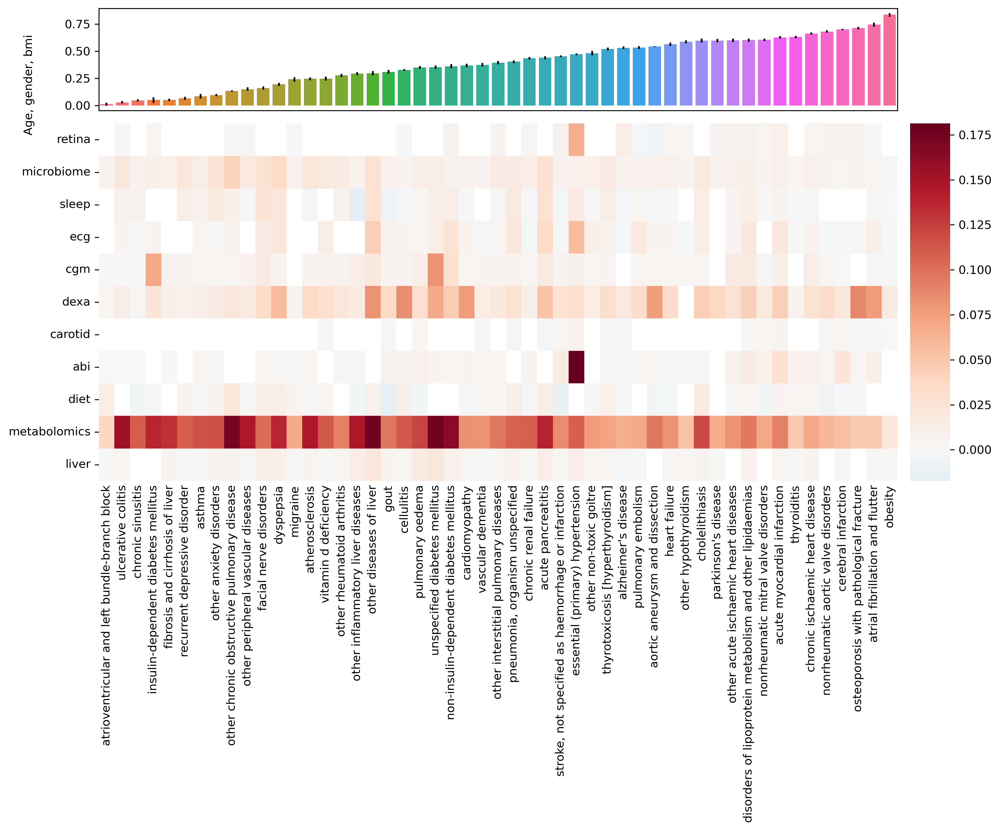

In [56]:
# Fig 4 - multivariate analysis
# run

### loader_lasso_outcomes = get_loader_lasso_outcomes()
### loader_agb_outcomes = get_loader_agb_lasso_outcomes()
loader_lasso_outcomes = get_loader_lasso_outcomes_multi()
loader_agb_outcomes = get_loader_agb_lasso_outcomes_multi()
lasso_outcomes, agb_outcomes = summarize_resamples(loader_lasso_outcomes, loader_agb_outcomes)

lasso_outcomes.to_csv(os.path.join(topdir,'lasso_outcomes_12_24.csv'))
agb_outcomes.to_csv(os.path.join(topdir,'agb_outcomes_12_24.csv'))

r2_deltas = get_r2_deltas(lasso_outcomes,agb_outcomes)
agb_r2s = get_agb_results_multi()
###agb_r2s = get_agb_results()

plot_r2_fig(r2_deltas, agb_r2s)


In [366]:
# from IPython.display import Image
# Image(filename=os.path.join(topdir,'r2_deltas_CI.png')) 

r2_deltas.loc['diet'].sort_values(ascending=False)

# max_indices = r2_deltas.idxmax()
# max_values = r2_deltas.max()
# result = pd.DataFrame({
#     'Max Index': max_indices,
#     'Max Value': max_values
# })
# result

other chronic obstructive pulmonary disease                  0.021704
cholelithiasis                                               0.017503
atrioventricular and left bundle-branch block                0.013306
acute pancreatitis                                           0.012427
dyspepsia                                                    0.011967
pneumonia, organism unspecified                              0.010907
facial nerve disorders                                       0.010856
cellulitis                                                   0.010391
thyrotoxicosis [hyperthyroidism]                             0.009632
other diseases of liver                                      0.009545
other anxiety disorders                                      0.006482
recurrent depressive disorder                                0.006417
acute myocardial infarction                                  0.004507
migraine                                                     0.004490
vitamin d deficiency

In [176]:
dx = loader_lasso_outcomes.filter(like='sleep',axis='index')
#dx = dx[dx<0].dropna(how='all').dropna(how='all',axis=1).notna().sum(axis=1)
# dx['chronic renal failure'].sort_values().head(n=50)
# loader_lasso_outcomes[loader_lasso_outcomes<0].dropna(how='all').head(n=60).dropna(how='all',axis=1)
# loader_lasso_outcomes.index[loader_lasso_outcomes.isna().sum(axis=1)>
# loader_lasso_outcomes.index[loader_lasso_outcomes[loader_lasso_outcomes<0].dropna(how='all').notna().sum(axis=1)>0]


(dx<0).sum()

# dx['atrioventricular and left bundle-branch block'].head(50)

# loader_lasso_outcomes[loader_lasso_outcomes<0].dropna(how='all').dropna(how='all',axis=1).filter(like='sleep',axis='index')

essential (primary) hypertension                              0
acute myocardial infarction                                   0
chronic ischaemic heart disease                               0
unspecified diabetes mellitus                                 0
asthma                                                        2
other diseases of liver                                       0
other inflammatory liver diseases                             0
fibrosis and cirrhosis of liver                               7
obesity                                                       0
insulin-dependent diabetes mellitus                           8
non-insulin-dependent diabetes mellitus                       0
other acute ischaemic heart diseases                          0
nonrheumatic aortic valve disorders                           0
nonrheumatic mitral valve disorders                           0
cardiomyopathy                                                0
heart failure                           

In [243]:
lasso_outcomes[(agb_outcomes<0.2) & ((lasso_outcomes-agb_outcomes) > 0.05)].dropna(how="all",axis=0).dropna(how="all",axis=1)
# lasso_outcomes[((lasso_outcomes-agb_outcomes) > 0.05)].dropna(how="all",axis=0).dropna(how="all",axis=1).notna().sum().sum()

,asthma,fibrosis and cirrhosis of liver,insulin-dependent diabetes mellitus,chronic sinusitis,other chronic obstructive pulmonary disease,facial nerve disorders,other anxiety disorders,recurrent depressive disorder,dyspepsia,other peripheral vascular diseases,ulcerative colitis
cgm,NaN,NaN,0.116940,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
dexa,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.221272,NaN,NaN
metabolomics,0.214338,0.189745,0.183753,0.16729,0.326044,0.292777,0.213295,0.175658,NaN,0.311922,0.191707


In [273]:
lasso_outcomes.loc['retina',:]

essential (primary) hypertension                             0.527711
acute myocardial infarction                                  0.633994
chronic ischaemic heart disease                              0.651418
unspecified diabetes mellitus                                     NaN
asthma                                                            NaN
other diseases of liver                                           NaN
other inflammatory liver diseases                                 NaN
fibrosis and cirrhosis of liver                                   NaN
obesity                                                           NaN
insulin-dependent diabetes mellitus                          0.063955
non-insulin-dependent diabetes mellitus                      0.379641
other acute ischaemic heart diseases                         0.601601
nonrheumatic aortic valve disorders                          0.700562
nonrheumatic mitral valve disorders                          0.617330
cardiomyopathy      

In [241]:
lasso_outcomes.filter(like='insulin-depe')

,insulin-dependent diabetes mellitus,non-insulin-dependent diabetes mellitus
retina,0.063955,0.379641
microbiome,0.059189,0.367193
sleep,NaN,0.372217
ecg,0.053446,0.390266
cgm,0.116940,0.385885
dexa,0.076344,0.414006
carotid,NaN,NaN
abi,NaN,0.370009
diet,0.057326,NaN
metabolomics,0.183753,0.515337


In [42]:
# check microbiome - smoking associations.
from LabData.DataLoaders.LifeStyleLoader import LifeStyleLoader
from LabData.DataLoaders.BodyMeasuresLoader import BodyMeasuresLoader
from LabData.DataLoaders.GutMBLoader import GutMBLoader
from LabData.DataAnalyses.UKBB_10k.process_predictions import load_medical, load_outcome, load_age_gender_bmi, load_microbiome

from scipy.stats import mannwhitneyu
import statsmodels.stats.multitest as smm


bm_md = BodyMeasuresLoader().get_data(study_ids=['10K'], research_stage=['baseline']).df_metadata
reg_ids = bm_md.index.get_level_values(0).tolist() # ids of everyone who has come in for a visit

data = LifeStyleLoader().get_data(study_ids=['10K'], research_stage=['baseline'],
                                                     groupby_reg='first',reg_ids=reg_ids,
                                                     ).df

smokers = ((data['tobacco_past_how_often'] == 1) | (data['smoke_tobacco_now']==1)).astype(int)
smokers = smokers.reset_index(level=[1]).drop(['Date'], axis=1)
print('Loaded smoking data')

mb = load_microbiome()

print('loaded_microbiome')

ids = smokers.index.intersection(mb.index)
smokers = smokers.loc[ids]
mb = mb.loc[ids]

mb_smoke = mb[smokers[0]==1]
mb_nonsmoke = mb[smokers[0]==0]

p_values = []
for microbe in mb.columns:
    stat, p = mannwhitneyu(mb_smoke[microbe], mb_nonsmoke[microbe], alternative='two-sided')
    p_values.append(p)
adjusted_p_values = smm.multipletests(p_values, method='bonferroni')[1]
results = pd.DataFrame({
    'microbe': mb.columns,
    'p_value': p_values,
    'adjusted_p_value': adjusted_p_values,
    'smokers_mean':mb_smoke.mean(),
    'nonsmokers_mean': mb_nonsmoke.mean()
})

results['enriched_in'] = results.apply(
    lambda row: 'smokers' if row['smokers_mean'] > row['nonsmokers_mean'] else 'nonsmokers',
    axis=1
)

significant_results = results[results['adjusted_p_value'] < 0.05]
significant_results = significant_results.sort_values(by='adjusted_p_value')

print(significant_results)


Loaded smoking data


/home/davidpel/PycharmProjects/LabData/LabData/DataLoaders/MBLoader.py:344: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df.sort_index(inplace=True)


loaded_microbiome
                                                                         microbe  \
species                                                                            
NK3B98_genus_Rep_3187_Rep_3187                    NK3B98_genus_Rep_3187_Rep_3187   
CAG-115 sp003531585_Rep_3450                        CAG-115 sp003531585_Rep_3450   
Lawsonibacter asaccharolyticus_Rep_3290  Lawsonibacter asaccharolyticus_Rep_3290   
Flavonifractor plautii_Rep_3275                  Flavonifractor plautii_Rep_3275   
CAG-81 sp900066785_Rep_2073                          CAG-81 sp900066785_Rep_2073   
Oscillibacter welbionis_Rep_3257                Oscillibacter welbionis_Rep_3257   
Coprococcus sp000154245_Rep_2160                Coprococcus sp000154245_Rep_2160   
UBA11774 sp003507655_Rep_2166                      UBA11774 sp003507655_Rep_2166   

                                              p_value  adjusted_p_value  \
species                                                           

In [53]:
import pingouin as pg
from statsmodels.stats.multitest import multipletests

results = []
for column in mb.columns:
    corr_result = pg.corr(mb[column], smokers[0],method='spearman')
    results.append(corr_result)

# Concatenate all the results into a single DataFrame
results_df = pd.concat(results, ignore_index=True)
results_df['column'] = mb.columns

_, pvals_adjusted, _, _ = multipletests(results_df['p-val'], method='bonferroni')

# Add the adjusted p-values to the DataFrame
results_df['p-val_adj'] = pvals_adjusted

# Filter the results to keep only those with an adjusted p-value less than 0.05
filtered_results_df = results_df[results_df['p-val_adj'] < 0.05]
filtered_results_df = filtered_results_df.sort_values(by='p-val_adj')

# Show the final DataFrame with columns and adjusted p-values
print(filtered_results_df[['column', 'r', 'p-val', 'p-val_adj']])


                                      column         r         p-val  \
375           NK3B98_genus_Rep_3187_Rep_3187 -0.054229  2.828974e-07   
438             CAG-115 sp003531585_Rep_3450 -0.052532  6.570834e-07   
416  Lawsonibacter asaccharolyticus_Rep_3290  0.052118  8.042074e-07   
409          Flavonifractor plautii_Rep_3275  0.049710  2.524560e-06   
117              CAG-81 sp900066785_Rep_2073 -0.043600  3.673588e-05   
402         Oscillibacter welbionis_Rep_3257  0.042838  5.016946e-05   
138         Coprococcus sp000154245_Rep_2160 -0.042611  5.499602e-05   
140            UBA11774 sp003507655_Rep_2166 -0.041568  8.335460e-05   

     p-val_adj  
375   0.000146  
438   0.000340  
416   0.000416  
409   0.001305  
117   0.018992  
402   0.025938  
138   0.028433  
140   0.043094  


In [14]:
# check metabolomics

from LabData.DataLoaders.LifeStyleLoader import LifeStyleLoader
from LabData.DataLoaders.BodyMeasuresLoader import BodyMeasuresLoader
from LabData.DataLoaders.SerumMetabolomicsLoader import SerumMetabolomicsLoader
from LabData.DataAnalyses.UKBB_10k.process_predictions import load_outcome, load_age_gender_bmi, load_metabolomics
from sklearn.experimental import enable_iterative_imputer  # Enable IterativeImputer
from sklearn.impute import IterativeImputer

df = load_metabolomics()

threshold = 0.7
row_threshold = int(df.shape[1] * threshold) 
col_threshold = int(df.shape[0] * threshold) 
print(row_threshold,col_threshold)
print(df.notna().sum())
print(df.notna().sum(axis=1))
df_cleaned = df.dropna(axis=0, thresh=row_threshold)  # Drop rows with <80% present
df_cleaned = df_cleaned.dropna(axis=1, thresh=col_threshold)  # Drop columns with <80% present
print("Original DataFrame:")
print(df.info())
print("\nCleaned and Imputed DataFrame:")
print(df_cleaned.info())
# Perform Iterative Imputation on the remaining DataFrame
imputer = IterativeImputer(verbose=1,n_nearest_features=100,max_iter = 1000)
df_imputed = pd.DataFrame(imputer.fit_transform(df_cleaned), 
                          columns=df_cleaned.columns, 
                          index=df_cleaned.index)

print(df_imputed)

2584 4325
Lipids_NEG_213.0551_31.1470_150.8722     3746
Lipids_NEG_217.0025_30.9563_142.6050     3850
Lipids_NEG_232.9752_30.7462_142.0463     5294
Lipids_NEG_255.8219_33.2194_130.6976     5908
Lipids_NEG_162.8391_33.8351_108.4717     4028
                                         ... 
Lipids_POS_634.4514_178.3280_253.8265    3171
Lipids_POS_502.3728_180.8955_229.8738    3269
Lipids_POS_356.3520_202.2460_210.9004    3308
Lipids_POS_312.3252_207.5235_196.5022    3191
Lipids_POS_458.3466_180.0755_222.7143    3242
Length: 3692, dtype: int64
RegistrationCode
10K_9018750047    2816
10K_2302377468    2821
10K_1156163709    2822
10K_8000222851    2815
10K_7498156799    2817
                  ... 
10K_5574192297    2288
10K_8123530624    2291
10K_8522415685    2291
10K_6910459237    2291
10K_7712670024    2292
Length: 6179, dtype: int64
Original DataFrame:
<class 'pandas.core.frame.DataFrame'>
Index: 6179 entries, 10K_9018750047 to 10K_7712670024
Columns: 3692 entries, Lipids_NEG_213.0551_31.14

[IterativeImputer] Change: 189.3903014724154, scaled tolerance: 0.07112669923154782 
[IterativeImputer] Change: 197.9337128710223, scaled tolerance: 0.07112669923154782 
[IterativeImputer] Change: 202.38155463854878, scaled tolerance: 0.07112669923154782 
[IterativeImputer] Change: 231.37922141381713, scaled tolerance: 0.07112669923154782 
[IterativeImputer] Change: 221.42178698232385, scaled tolerance: 0.07112669923154782 
[IterativeImputer] Change: 202.9835223035053, scaled tolerance: 0.07112669923154782 
[IterativeImputer] Change: 202.09732334269444, scaled tolerance: 0.07112669923154782 
[IterativeImputer] Change: 192.2204518523552, scaled tolerance: 0.07112669923154782 
[IterativeImputer] Change: 203.51707604915853, scaled tolerance: 0.07112669923154782 
[IterativeImputer] Change: 220.4781274882301, scaled tolerance: 0.07112669923154782 
[IterativeImputer] Change: 193.62203483667142, scaled tolerance: 0.07112669923154782 
[IterativeImputer] Change: 203.2471299989438, scaled tolera

/home/davidpel/anaconda3/lib/python3.9/site-packages/sklearn/impute/_iterative.py:785: ConvergenceWarning: [IterativeImputer] Early stopping criterion not reached.
  warnings.warn(


                  Lipids_NEG_232.9752_30.7462_142.0463  \
RegistrationCode                                         
10K_9018750047                                1.528883   
10K_2302377468                                3.287143   
10K_1156163709                                1.481742   
10K_8000222851                                1.415948   
10K_7498156799                                1.339643   
...                                                ...   
10K_1045275410                               -1.327002   
10K_4212384341                               -1.327002   
10K_2054267008                               -1.327002   
10K_3722747918                               -0.882967   
10K_6205511815                               -1.327002   

                  Lipids_NEG_255.8219_33.2194_130.6976  \
RegistrationCode                                         
10K_9018750047                                0.204892   
10K_2302377468                                0.451630   
10K_115616370

In [15]:
df_imputed.to_csv(os.path.join(outdir,'metabolomics_cleaned_imputed_100_iters.csv'))

In [32]:
df_imputed = pd.read_csv(os.path.join(outdir,'metabolomics_cleaned_imputed.csv'),index_col=0)


Loaded age, gender, bmi
Explained Variance by Component: [9.17994896 8.03796161 6.9211531  4.27160815 4.01187156 3.14719474
 2.84306304 2.45735878 2.28240555 2.12318511 1.98049037 1.76303742
 1.47841921 1.40966916 1.32229991 1.06810285 0.97836536 0.89742506
 0.85969675 0.7233968  0.70138712 0.6574231  0.64370227 0.62673685
 0.59945529 0.52608682 0.5109517  0.50471791 0.44289503 0.43015617
 0.41039112 0.38899111 0.38140135 0.35392374 0.34553138 0.33492453
 0.32855014 0.31217852 0.30224642 0.29520499 0.28637852 0.26644142
 0.2617944  0.25082274 0.239759   0.23418101 0.22993466 0.22510373
 0.22423761 0.21655534 0.21091044 0.2050225  0.19907964 0.19158268
 0.19022327 0.18719558 0.18087475 0.17757549 0.17125155 0.16892771
 0.16617146 0.16362089 0.16165221 0.16039386 0.15464727 0.15200979
 0.15088841 0.14794177 0.14406395 0.14004121 0.1379084  0.13580466
 0.13452001 0.13280443 0.12803868 0.12707188 0.12651267 0.1203878
 0.11999816 0.11925394 0.11685125 0.1139057  0.11203659 0.11145793
 0.110

<Figure size 640x480 with 0 Axes>

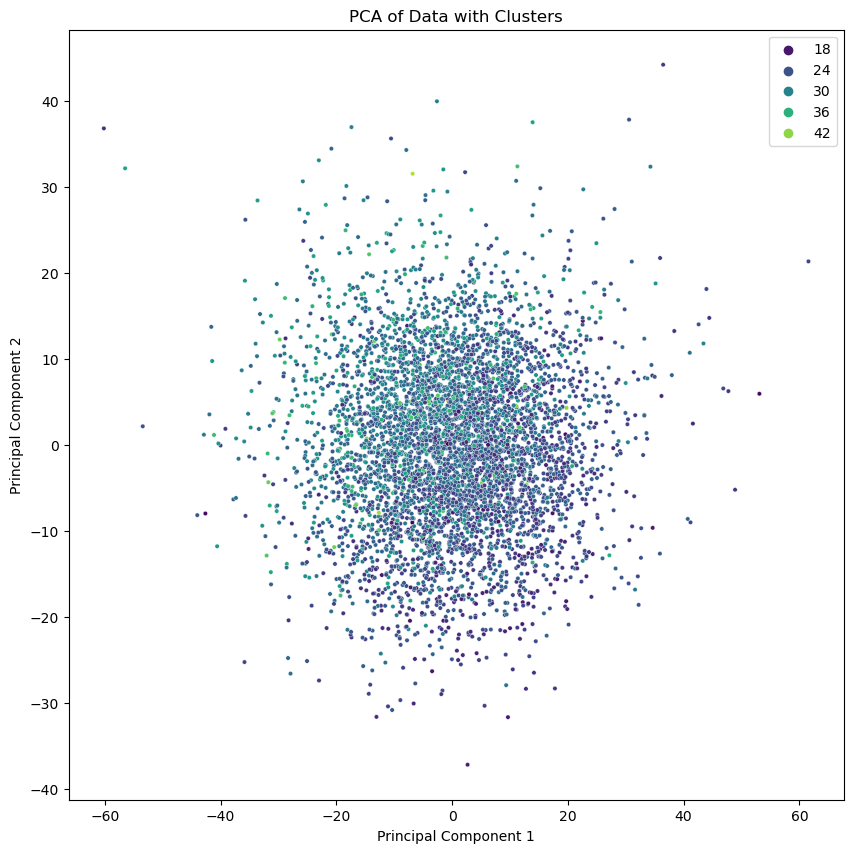

Explained Variance by Component: [9.58477818 8.15550649 6.96225319 4.56844187 3.95939394 3.16149422
 2.90147664 2.52321227 2.27784411 1.99049421 1.87136863 1.68165437
 1.48491859 1.38723594 1.16781328 1.0705144  0.95039755 0.88430366
 0.78468333 0.75140213 0.72973017 0.68330142 0.65319785 0.64092397
 0.59101905 0.5228137  0.5045282  0.48930233 0.43807632 0.42295495
 0.40300669 0.39984491 0.37816881 0.35087222 0.34799248 0.34260828
 0.33488102 0.32324801 0.30397807 0.2953245  0.28614548 0.2734752
 0.26735125 0.25344974 0.24903084 0.24245553 0.23521844 0.22974478
 0.22462916 0.21910239 0.20881463 0.20710031 0.20134328 0.19452374
 0.19413765 0.18875384 0.18640748 0.18478076 0.18188945 0.17810237
 0.17223917 0.17018919 0.16772437 0.16487301 0.16095244 0.15806426
 0.15296913 0.15161027 0.14822477 0.14727423 0.14539311 0.14260341
 0.14140122 0.13898396 0.1347158  0.13200547 0.12918503 0.12798679
 0.12730528 0.12520157 0.12266375 0.12178831 0.11910851 0.11770856
 0.11549812 0.11335674 0.11198

<Figure size 640x480 with 0 Axes>

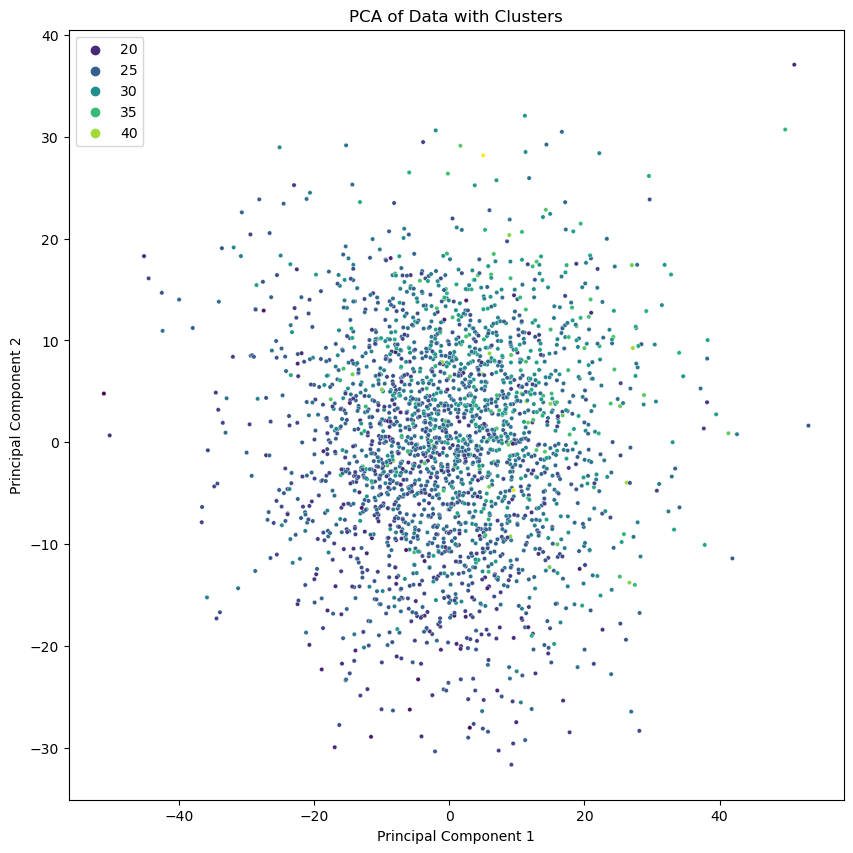

Explained Variance by Component: [9.24211409 7.96708436 6.38416801 4.31896765 4.03923394 3.19949792
 2.86286096 2.48747067 2.36476653 2.07935169 1.87368163 1.73577418
 1.50148396 1.46908308 1.18487162 1.07642448 0.9663755  0.91250311
 0.8932936  0.74631094 0.69605683 0.673232   0.63491816 0.61383528
 0.59346629 0.55535064 0.52598711 0.52542842 0.48663487 0.43661402
 0.43276623 0.39789229 0.39056195 0.36014455 0.35095208 0.34515986
 0.33873049 0.32168304 0.31256235 0.29812165 0.28489632 0.27805637
 0.26790717 0.25623568 0.25362532 0.25114372 0.23547835 0.23264257
 0.23000554 0.2285137  0.22066408 0.21601543 0.21122979 0.19888461
 0.19687233 0.19229763 0.19190029 0.18864171 0.18248338 0.17676422
 0.17382314 0.17014633 0.1686606  0.16798822 0.16312844 0.15961708
 0.15624403 0.15375909 0.150409   0.14485505 0.14243774 0.13966139
 0.13704768 0.1356251  0.13417545 0.12897752 0.12740911 0.12623865
 0.12440531 0.12347879 0.12237585 0.11806081 0.11767904 0.11762163
 0.11547727 0.11315497 0.1113

<Figure size 640x480 with 0 Axes>

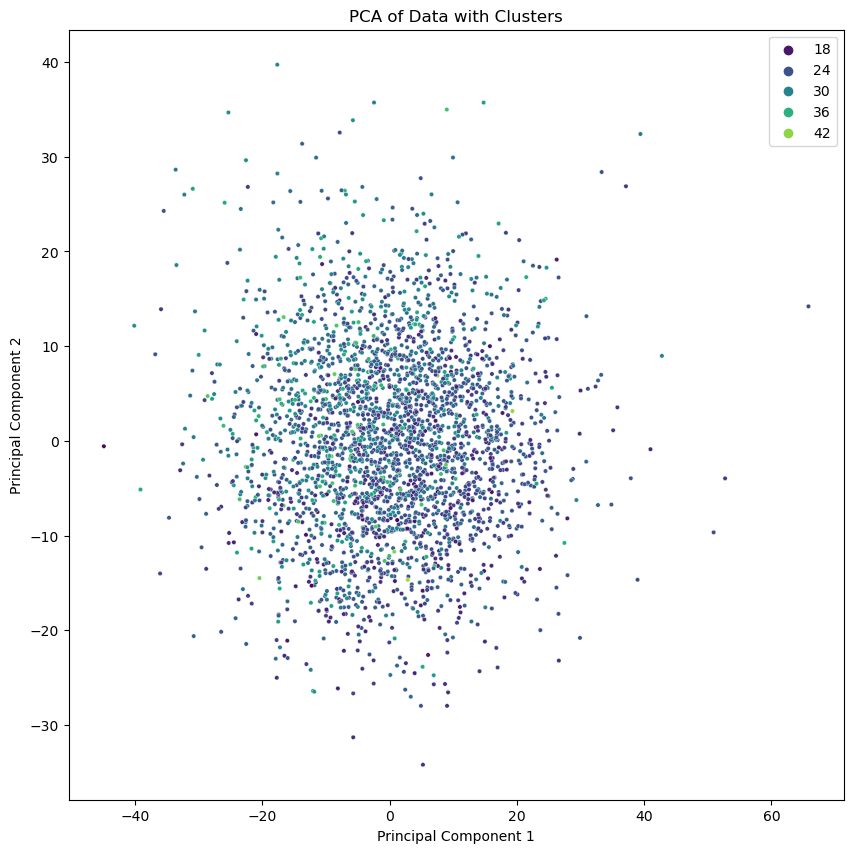

In [35]:
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.mixture import GaussianMixture
from sklearn.metrics import silhouette_score
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LinearRegression
from sklearn.manifold import TSNE
import umap

def pca_plot_gendered(df,gender):
    
    # regress out age and bmi
    X = df.drop(columns=['age','bmi'])
#     residuals = pd.DataFrame(index=df.index)

#     for column in X.columns:  # Iterate over the original features
#         y = df[column]  # Feature to adjust
#         X = df[['age', 'bmi']]  # Covariates
#         model = LinearRegression()
#         model.fit(X, y)
#         predicted = model.predict(X)  # Predicted values based on age and BMI
#         residuals[column] = y - predicted  # Store the residuals

#     # Residuals are the dataset with age and BMI regressed out
#     X_adjusted = residuals
    
    scaler = StandardScaler()
    df_scaled = scaler.fit_transform(X)
    
#     ncomp=65
    pca = PCA(n_components=0.95)
    
    pca_res = pca.fit_transform(df_scaled)
    df_pca = pd.DataFrame(pca_res,columns=[f'PC{i+1}' for i in range(pca.n_components_)],index=df.index)
    
    
    explained_variance = pca.explained_variance_ratio_ * 100
    print(f"Explained Variance by Component: {explained_variance}")
    print(f"Cumulative Explained Variance: {np.cumsum(explained_variance)}")
    
    # Print PCA loadings
    loadings = pd.DataFrame(pca.components_.T, columns=df_pca.columns, index=X.columns)
    print("\nPCA Loadings:")
    print(loadings)

    
#     tsne = TSNE(n_components=2)
#     tsne_results = tsne.fit_transform(df_pca)

#     # Create a new DataFrame with t-SNE results
#     df_tsne = pd.DataFrame(tsne_results, columns=[f'TSNE{i+1}' for i in range(tsne.embedding_.shape[1])], index=df.index)


#     umap_reducer = umap.UMAP(
#         n_neighbors=20,  # Controls local structure
#         min_dist=0.007,    # Controls spacing of points in the low-dimensional space
#         n_components=2,  # Number of dimensions for the embedding
#        # random_state=42  # Ensures reproducibility
#     )

#     # Run UMAP on the DataFrame
#     umap_embedding = umap_reducer.fit_transform(df_scaled)
#     print(umap_embedding)

#     # Convert UMAP embedding to a DataFrame for easier plotting
#     df_umap = pd.DataFrame(umap_embedding, columns=['UMAP1', 'UMAP2'])
#     print(df_umap)
    
#     df_umap['bmi'] = df.reset_index(drop=True)['bmi']
    
#     print(df_umap)
    
# #     for col in df.columns:
# #         df_umap[col] = df[col]    

#     plt.clf()
#     plt.figure(figsize=(10, 10))
#     # Plot the t-SNE
#     sns.scatterplot(
#         x='UMAP1', y='UMAP2', data=df_umap,
#         hue = 'bmi', palette='viridis',  # Replace with 'gender' or another column if desired
#         s=10
#     )

#     plt.title("UMAP Visualization")
#     plt.show()
    
#     silhouette_scores = []
#     k_range = range(2, 56)  # Test clusters from 2 to 10
#     for k in k_range:
#         kmeans = KMeans(n_clusters=k)
#         labels = kmeans.fit_predict(df_pca)
# #         gmm = GaussianMixture(n_components=k)
# #         labels = gmm.fit_predict(df_pca)
#         silhouette_scores.append(silhouette_score(df_pca, labels))

#     optimal_k = 3#k_range[np.argmax(silhouette_scores)]
# #     print(silhouette_scores)
#     print(f"Optimal number of clusters: {optimal_k}")
    
# #     kmeans = KMeans(n_clusters=optimal_k)
# #     cluster_labels = kmeans.fit_predict(df_pca)#.drop(columns='PC1'))#[['PC2','PC4']])
#     gmm = GaussianMixture(n_components=optimal_k)
#     cluster_labels = gmm.fit_predict(df_pca)#.drop(columns='PC1'))#[['PC2','PC4']])
#     df_pca['Cluster'] = cluster_labels

    df_pca['age'] = df['age']
    df_pca['bmi'] = df['bmi']
    
    
# #     clust1 = df[(df_pca['PCA4']<=0)]
# #     clust2 = df[~(df_pca['PCA4']<=0)]
    
# #     print(clust1.mean())
# #     print(clust2.mean())
    
# #     print((clust1.mean()-clust2.mean()).sort_values())

#     # Step 5: Plot PCA with clusters
    plt.clf()
    plt.figure(figsize=(10, 10))
    sns.scatterplot(
        x='PC3', y='PC4', hue='bmi', data=df_pca,
        palette='viridis',  s=10
    )
    plt.title("PCA of Data with Clusters")
    plt.xlabel("Principal Component 1")
    plt.ylabel("Principal Component 2")
    plt.legend(title="")
    plt.show()


def plot_pca(df):
    age_gender_bmi = load_age_gender_bmi()
    merged = df.merge(age_gender_bmi,how='inner',left_index=True, right_index=True).dropna(how='any')
    df_m = merged[merged['gender']==1].drop(columns='gender').dropna(how='any')
    df_f = merged[merged['gender']==0].drop(columns='gender').dropna(how='any')
    pca_plot_gendered(merged.drop(columns='gender'),'All')
    pca_plot_gendered(df_m,'Male')
    pca_plot_gendered(df_f,'Female')
    
plot_pca(df_imputed)